# Open University Dataset 

## Preliminaries

### Import Packages

In [1]:
import sys
sys.path.append('..')
from utilities import * 

### Constants

In [2]:
# paths
PATH_TO_INTERACTION_DATA = '../../../../../../data/ddia/open_university/anonymisedData/studentVle.csv'
PATH_TO_STUDENT_DEMOGRAPHIC_DATA = '../../../../../../data/ddia/open_university/anonymisedData/studentInfo.csv'
PATH_TO_ASSESSMENT_DATA = '../../../../../../data/ddia/open_university/anonymisedData/assessments.csv'
PATH_TO_STUDENT_ASSESSMENT_DATA = '../../../../../../data/ddia/open_university/anonymisedData/studentAssessment.csv'

# dataset name
DATASET_NAME = 'open_university'

# fields used in the analysis
USER_FIELD = 'id_student'
GROUP_FIELD = 'id_module'
LEARNING_ACTIVITY_FIELD = 'id_site'
COURSE_FIELD = 'Course'
TIMESTAMP_FIELD = 'custom_timestamp'

# fields used in dataset preparation
MODULE_FIELD = 'code_module'
PRESENTATION_FIELD = 'code_presentation'
FINAL_RESULT_FIELD = 'final_result'
WEIGHT_FIELD = 'weight'
SCORE_FIELD = 'score'
SUM_CLICK_FIELD = 'sum_click'

# strings and values used in dataset preparation
FINAL_RESULT_PASS_VALUE_STR = 'Pass'
FINAL_RESULT_DISTINCTION_VALUE_STR = 'Distinction'

# evaluation fields
# learning activity level
EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD = None
EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD = None
# group level
EVALUATION_GROUP_SCORE_FIELD = 'Score'
EVALUATION_GROUP_IS_CORRECT_FIELD = 'Is Correct' 
# course level
EVALUATION_COURSE_SCORE_FIELD = None
EVALUATION_COURSE_IS_CORRECT_FIELD = None 

# score threshold is correct
EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD = None
EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD = None
EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD = None

# evaluation min and max in dataset docu
EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU = None

# used for generating html tables
HTML_TABLES_DATA_LIST = [[LEARNING_ACTIVITY_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD, EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD, EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [GROUP_FIELD, EVALUATION_GROUP_SCORE_FIELD, EVALUATION_GROUP_IS_CORRECT_FIELD, EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD, EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [COURSE_FIELD, EVALUATION_COURSE_SCORE_FIELD, EVALUATION_COURSE_IS_CORRECT_FIELD, EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD, EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU]]

### Import Pickled Objects

In [3]:
# seq_distances = pickle_read(PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
#                             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

# learning_activity_sequence_stats_per_group = pickle_read(PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
#                                                          DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

# html_table = pickle_read(PATH_TO_HTML_TABLES_PICKLE_FOLDER,
#                          DATASET_NAME + HTML_TABLES_PICKLE_NAME)

# cluster_eval = pickle_read(PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
#                            DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

### Functions

In [4]:
def calculate_eval_metrics(df: pd.DataFrame,
                           sum_click_field=None):
    """Calculate evaluation metrics per single learning_activity. This function should be used as input of the
    add_evaluation_fields function.

    Parameters
    ----------
    df : pd.DataFrame
        A subset of the interactions dataframe containing data of a single learning_activity
    sum_click_field : _type_
        The learning_activity sum_click field column used to approximate interactions, by default None

    Returns
    -------
    tuple
        A tuple of evaluation metric scalars per learning activity
    """
    df = df.copy()

    # number interactions 
    number_interactions_total = df[sum_click_field].sum()

    # number attempts
    number_attempts_total = None

    # number hints
    number_hints_total = None

    # total time
    time_total = None
        
    # scores
    # single score
    single_score = None
    # single score hint lowest 
    single_score_hint_lowest = None 
    # single score not first attempt lowest
    single_score_not_first_attempt_lowest = None
    # highest score
    score_highest = None
    # highest score without hint
    score_highest_without_hint = None
    # score first attempt
    score_first_attempt = None
    # score last attempt
    score_last_attempt = None
    # number interactions until highest score
    number_interactions_until_score_highest = None
    # number attempts until highest score
    number_attempts_until_score_highest = None
    # number hints until highest score
    number_hints_until_score_highest = None
    # time until highest score
    time_until_score_highest = None

    # corrects
    # correct
    is_correct = None
    # correct without hint
    is_correct_without_hint = None
    # correct first attempt
    is_correct_first_attempt = None
    # correct first attempt without hint
    is_correct_first_attempt_without_hint = None
    # correct last attempt
    is_correct_last_attempt = None
    # correct last attempt without hint
    is_correct_last_attempt_without_hint = None
    # number interactions until correct
    number_interactions_until_correct = None
    # number attempts until correct
    number_attempts_until_correct = None
    # number hints until correct
    number_hints_until_correct = None
    # time until correct
    time_until_correct = None

    return (number_interactions_total,
            number_attempts_total,
            number_hints_total,
            time_total,
            single_score,
            single_score_hint_lowest,
            single_score_not_first_attempt_lowest,
            score_highest,
            score_highest_without_hint,
            score_first_attempt,
            score_last_attempt,
            number_interactions_until_score_highest,
            number_attempts_until_score_highest,
            number_hints_until_score_highest,
            time_until_score_highest,
            is_correct,
            is_correct_without_hint,
            is_correct_first_attempt,
            is_correct_first_attempt_without_hint,
            is_correct_last_attempt,
            is_correct_last_attempt_without_hint,
            number_interactions_until_correct,
            number_attempts_until_correct,
            number_hints_until_correct,
            time_until_correct)

def merge_columns(dataframe: pd.DataFrame, col_1: str, col_2: str, merged_col_name: str):
    """Merges two columns of dataframe together

    Parameters
    ----------
    dataframe : pd.DataFrame
        A pandas dataframe
    col_1 : str
        The field name of the first column
    col_2 : str
        The field name of the second column
    merged_col_name : str
        The name of the merged 

    Returns
    -------
    _type_
        _description_
    """
    new_series = dataframe[col_1] + '_' + dataframe[col_2]
    dataframe = dataframe.drop([col_1, col_2], axis=1)

    dataframe[merged_col_name] = new_series

    return dataframe

def add_new_ascending_integers_timestamp_per_group_user_comb(interactions: pd.DataFrame, 
                                                             group_field: str, 
                                                             user_field: str, 
                                                             new_timestamp_field: str):
    """Add a new timestamp field to the interactions dataframe that consists of ascending integers (start=1) for all group-user pairs

    Parameters
    ----------
    interactions : pd.DataFrame
        The interactions dataframe
    group_field : str
        The group field column
    user_field : str
        The user field column
    new_timestamp_field : str
        The new timestamp field column

    Returns
    -------
    pd.DataFrame
        A dataframe that has a new timestamp field which consists of ascending integers (start=1) for all group user pairs
    """
    new_timestamp_list = []
    new_index_list = []

    for group, df in interactions.groupby([group_field, user_field]):
        length_df = len(df) 
        new_timestamp = list(range(1, length_df+1, 1)) 
        index = df.index
        
        new_timestamp_list.extend(new_timestamp)
        new_index_list.extend(index)

    new_timestamp_series = pd.Series(new_timestamp_list, index=new_index_list, name=new_timestamp_field)

    interactions = interactions.merge(new_timestamp_series, left_index=True, right_index=True)

    return interactions

## Dataset Preparation

### Import Data

In [5]:
interactions = pd.read_csv(PATH_TO_INTERACTION_DATA)
student_demographics = pd.read_csv(PATH_TO_STUDENT_DEMOGRAPHIC_DATA)
assessments = pd.read_csv(PATH_TO_ASSESSMENT_DATA)
student_assessments = pd.read_csv(PATH_TO_STUDENT_ASSESSMENT_DATA)

In [6]:
interactions

,code_module,code_presentation,id_student,id_site,date,sum_click
0,AAA,2013J,28400,546652,-10,4
1,AAA,2013J,28400,546652,-10,1
2,AAA,2013J,28400,546652,-10,1
3,AAA,2013J,28400,546614,-10,11
4,AAA,2013J,28400,546714,-10,1
...,...,...,...,...,...,...
10655275,GGG,2014J,675811,896943,269,3
10655276,GGG,2014J,675578,896943,269,1
10655277,GGG,2014J,654064,896943,269,3
10655278,GGG,2014J,654064,896939,269,1


In [7]:
student_demographics

,code_module,code_presentation,id_student,gender,region,highest_education,imd_band,age_band,num_of_prev_attempts,studied_credits,disability,final_result
0,AAA,2013J,11391,M,East Anglian Region,HE Qualification,90-100%,55<=,0,240,N,Pass
1,AAA,2013J,28400,F,Scotland,HE Qualification,20-30%,35-55,0,60,N,Pass
2,AAA,2013J,30268,F,North Western Region,A Level or Equivalent,30-40%,35-55,0,60,Y,Withdrawn
3,AAA,2013J,31604,F,South East Region,A Level or Equivalent,50-60%,35-55,0,60,N,Pass
4,AAA,2013J,32885,F,West Midlands Region,Lower Than A Level,50-60%,0-35,0,60,N,Pass
...,...,...,...,...,...,...,...,...,...,...,...,...
32588,GGG,2014J,2640965,F,Wales,Lower Than A Level,10-20,0-35,0,30,N,Fail
32589,GGG,2014J,2645731,F,East Anglian Region,Lower Than A Level,40-50%,35-55,0,30,N,Distinction
32590,GGG,2014J,2648187,F,South Region,A Level or Equivalent,20-30%,0-35,0,30,Y,Pass
32591,GGG,2014J,2679821,F,South East Region,Lower Than A Level,90-100%,35-55,0,30,N,Withdrawn


In [8]:
assessments

,code_module,code_presentation,id_assessment,assessment_type,date,weight
0,AAA,2013J,1752,TMA,19.0,10.0
1,AAA,2013J,1753,TMA,54.0,20.0
2,AAA,2013J,1754,TMA,117.0,20.0
3,AAA,2013J,1755,TMA,166.0,20.0
4,AAA,2013J,1756,TMA,215.0,30.0
...,...,...,...,...,...,...
201,GGG,2014J,37443,CMA,229.0,0.0
202,GGG,2014J,37435,TMA,61.0,0.0
203,GGG,2014J,37436,TMA,124.0,0.0
204,GGG,2014J,37437,TMA,173.0,0.0


In [9]:
student_assessments

,id_assessment,id_student,date_submitted,is_banked,score
0,1752,11391,18,0,78.0
1,1752,28400,22,0,70.0
2,1752,31604,17,0,72.0
3,1752,32885,26,0,69.0
4,1752,38053,19,0,79.0
...,...,...,...,...,...
173907,37443,527538,227,0,60.0
173908,37443,534672,229,0,100.0
173909,37443,546286,215,0,80.0
173910,37443,546724,230,0,100.0


In [10]:
PATH_TO_VLE_DATA = '../../../../../../data/ddia/open_university/anonymisedData/vle.csv'
vle = interactions = pd.read_csv(PATH_TO_VLE_DATA)

In [11]:
vle

,id_site,code_module,code_presentation,activity_type,week_from,week_to
0,546943,AAA,2013J,resource,NaN,NaN
1,546712,AAA,2013J,oucontent,NaN,NaN
2,546998,AAA,2013J,resource,NaN,NaN
3,546888,AAA,2013J,url,NaN,NaN
4,547035,AAA,2013J,resource,NaN,NaN
...,...,...,...,...,...,...
6359,897063,GGG,2014J,resource,NaN,NaN
6360,897109,GGG,2014J,resource,NaN,NaN
6361,896965,GGG,2014J,oucontent,NaN,NaN
6362,897060,GGG,2014J,resource,NaN,NaN


In [12]:
vle.activity_type.value_counts()

resource          2660
subpage           1055
oucontent          996
url                886
forumng            194
quiz               127
page               102
oucollaborate       82
questionnaire       61
ouwiki              49
dataplus            28
externalquiz        26
homepage            22
ouelluminate        21
glossary            21
dualpane            20
repeatactivity       5
htmlactivity         4
sharedsubpage        3
folder               2
Name: activity_type, dtype: int64

### Set Data Type

In [6]:
interactions = typecast_fields(interactions,
                               None,
                               None,
                               USER_FIELD,
                               LEARNING_ACTIVITY_FIELD)

student_demographics = typecast_fields(student_demographics,
                                       None,
                                       None,
                                       USER_FIELD,
                                       None)

student_assessments = typecast_fields(student_assessments,
                                       None,
                                       None,
                                       USER_FIELD,
                                       None)

### Merge and Filter Data

In [7]:
# calculate the score per group as weighted average of individual assessments
assessments = merge_columns(assessments, MODULE_FIELD, PRESENTATION_FIELD, GROUP_FIELD)
student_assessments = student_assessments.merge(assessments, how='left', on='id_assessment')

group_list = []
user_list = []
score_list = []
for fields_tuple, df in student_assessments.groupby([GROUP_FIELD, USER_FIELD]):
    normalized_weights = df[WEIGHT_FIELD] / sum(df[WEIGHT_FIELD])
    overall_score = sum(df[SCORE_FIELD] * normalized_weights)
    group_list.append(fields_tuple[0])
    user_list.append(fields_tuple[1])
    score_list.append(overall_score)
score_df = pd.DataFrame({GROUP_FIELD: group_list,
                         USER_FIELD: user_list,
                         EVALUATION_GROUP_SCORE_FIELD: score_list})

In [8]:
interactions = merge_columns(interactions, MODULE_FIELD, PRESENTATION_FIELD, GROUP_FIELD)
interactions = add_new_ascending_integers_timestamp_per_group_user_comb(interactions, 
                                                                        GROUP_FIELD, 
                                                                        USER_FIELD,
                                                                        TIMESTAMP_FIELD)
student_demographics = merge_columns(student_demographics, MODULE_FIELD, PRESENTATION_FIELD, GROUP_FIELD)
interactions = interactions.merge(student_demographics[[GROUP_FIELD, USER_FIELD, FINAL_RESULT_FIELD]], how="left", on=[GROUP_FIELD, USER_FIELD])
interactions = interactions.merge(score_df, how="left", on=[GROUP_FIELD, USER_FIELD])
interactions[EVALUATION_GROUP_IS_CORRECT_FIELD] = ((interactions[FINAL_RESULT_FIELD] == FINAL_RESULT_PASS_VALUE_STR) | (interactions[FINAL_RESULT_FIELD] == FINAL_RESULT_DISTINCTION_VALUE_STR))

### Transform Categorical Variable Values

In [9]:
interactions, value_mapping_df = map_new_to_old_values(interactions, 
                                                       GROUP_FIELD, 
                                                       USER_FIELD, 
                                                       LEARNING_ACTIVITY_FIELD)

### Filter Sequences by NAs in Dataset 

In [10]:
pct_na = get_nas_in_data(interactions)
pct_na

id_student                         0.0 %
id_site                            0.0 %
date                               0.0 %
sum_click                          0.0 %
id_module                          0.0 %
custom_timestamp                   0.0 %
final_result                       0.0 %
Score               5.0915227004827655 %
Is Correct                         0.0 %
dtype: object

In [11]:
interactions, na_indices_list = drop_learning_activity_sequence_if_contains_na_in_field(interactions, 
                                                                                        GROUP_FIELD, 
                                                                                        USER_FIELD, 
                                                                                        field_list=[TIMESTAMP_FIELD, 
                                                                                                    LEARNING_ACTIVITY_FIELD,
                                                                                                    EVALUATION_GROUP_SCORE_FIELD,
                                                                                                    EVALUATION_GROUP_IS_CORRECT_FIELD], 
                                                                                        field_value_tuple_filter_list=[])



Input length: 10655280
Outpunt length: 10112764
Number of rows removed: 542516
Percentage of rows removed: 5.0915%
--------------------------------------------------
Input number of sequences: 29228
Output number of sequences: 23305
Number of sequences removed: 5923
Percentage of sequences removed: 20.2648%


In [12]:
interactions = drop_na_by_fields(interactions,
                                 field_list=[GROUP_FIELD,
                                             USER_FIELD])

Input length: 10112764
Outpunt length: 10112764
Number of rows removed: 0
Percentage of rows removed: 0%


In [13]:
pct_na = get_nas_in_data(interactions)
pct_na

id_student          0.0 %
id_site             0.0 %
date                0.0 %
sum_click           0.0 %
id_module           0.0 %
custom_timestamp    0.0 %
final_result        0.0 %
Score               0.0 %
Is Correct          0.0 %
dtype: object

### Sort by Timestamp

In [14]:
interactions = sort_by_timestamp(interactions, 
                                 TIMESTAMP_FIELD, 
                                 higher_level_sort_list=[GROUP_FIELD, USER_FIELD])

### Evaluation Score Fields Ranges

Topic Evaluation Score Range:

Number of Topics: 19
Number of Unique Score Ranges: 14
Minima of Topic Ranges are all equal: False
Maxima of Topic Ranges are all equal: False
Minimum Topic Score: 0.0
Maximum Topic Score: 100.0


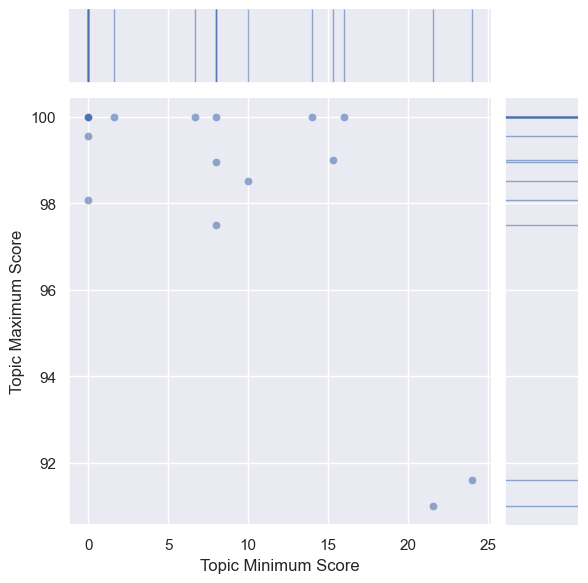

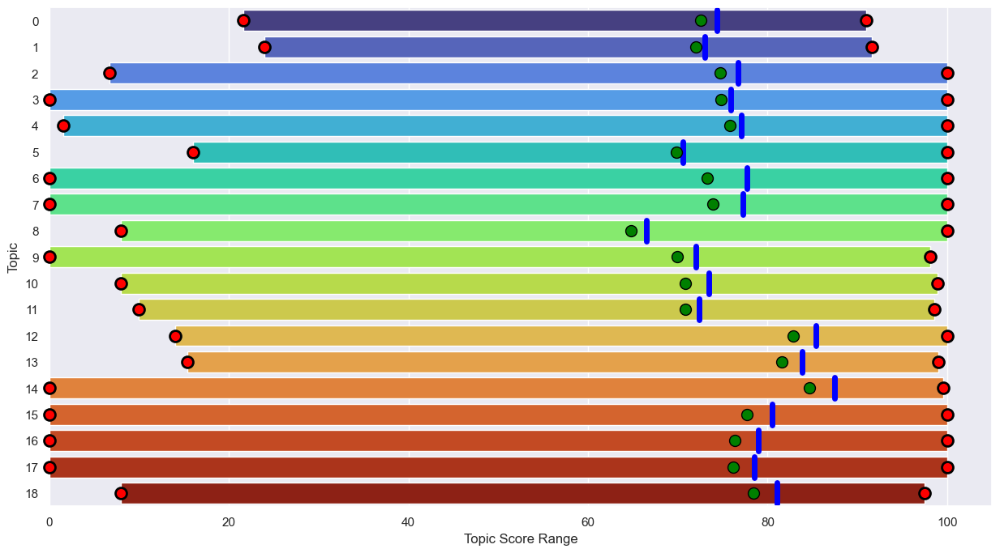

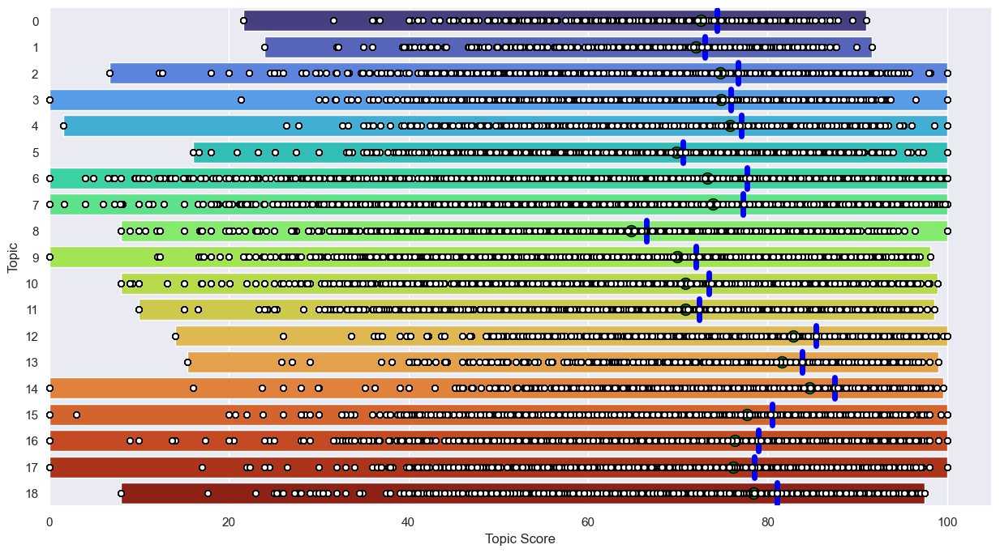

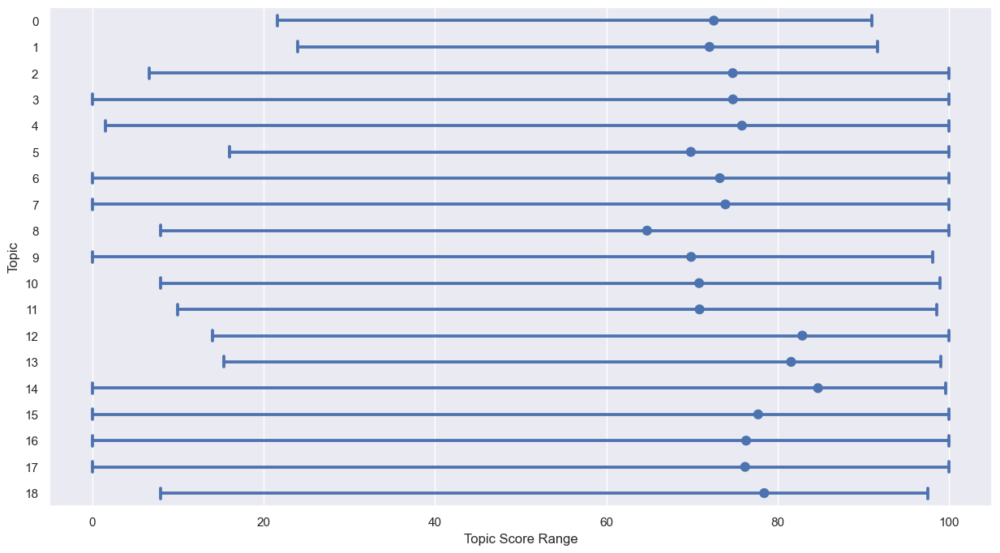

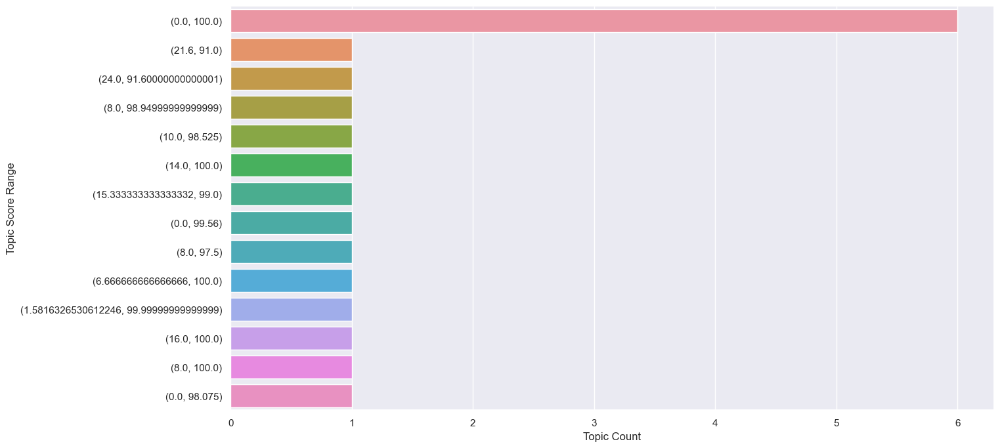

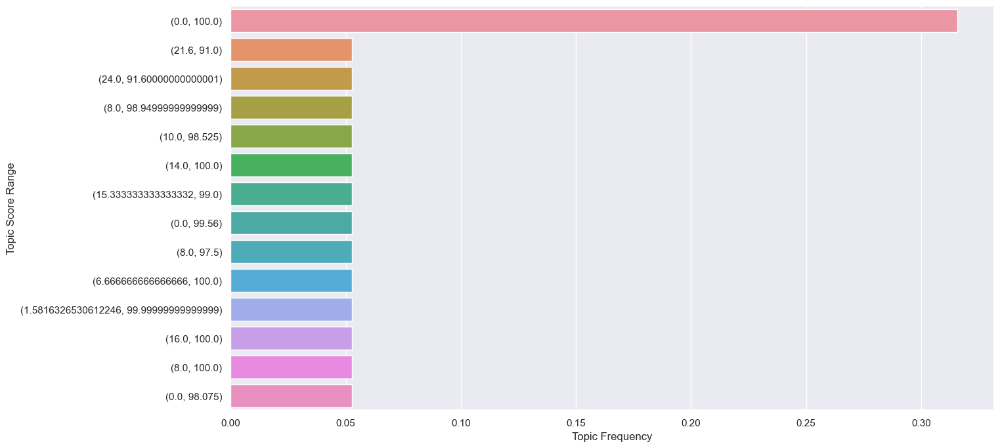

In [15]:
evaluation_score_range_dict = return_and_plot_evaluation_score_range(interactions,
                                                                     LEARNING_ACTIVITY_FIELD,
                                                                     None,
                                                                     GROUP_FIELD,
                                                                     EVALUATION_GROUP_SCORE_FIELD,
                                                                     None)

### Transform Data

#### Add Evaluation Fields

In [17]:
interactions = add_evaluation_fields(interactions,
                                     GROUP_FIELD,
                                     USER_FIELD,
                                     LEARNING_ACTIVITY_FIELD,
                                     TIMESTAMP_FIELD,
                                     None,
                                     np.mean,
                                     EVALUATION_GROUP_SCORE_FIELD,
                                     EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     EVALUATION_COURSE_SCORE_FIELD,
                                     EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     False,
                                     False,
                                     EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD,
                                     EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD,
                                     operator.gt,
                                     operator.gt,
                                     calculate_eval_metrics,
                                     sum_click_field=SUM_CLICK_FIELD)

100%|██████████| 23305/23305 [00:04<00:00, 5239.94it/s] 


= Repeated Interactions Removal =
Initial number of interactions: 10112764
Final number of interactions: 9060962
Removed number of interactions: 1051802
Removed percentage of interactions: 10.400737127851494%


### Rename Fields

In [18]:
interactions, fields_mapping_df = rename_fields(interactions,
                                                GROUP_FIELD,
                                                USER_FIELD,
                                                LEARNING_ACTIVITY_FIELD,
                                                TIMESTAMP_FIELD)

### Add Sequence ID Field

In [19]:
interactions = add_sequence_id_field(interactions,
                                     GROUP_FIELD_NAME_STR,
                                     USER_FIELD_NAME_STR,
                                     LEARNING_ACTIVITY_FIELD_NAME_STR)

### Check Dataset

In [20]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9060962 entries, 0 to 9060961
Data columns (total 86 columns):
 #   Column                                                                                   Dtype  
---  ------                                                                                   -----  
 0   Timestamp                                                                                int64  
 1   User                                                                                     object 
 2   Topic                                                                                    object 
 3   Learning Resource                                                                        object 
 4   Sequence ID                                                                              object 
 5   Learning Resource Interactions Total                                                     int64  
 6   Learning Resource Attempts Total                                  

In [21]:
pct_na = get_nas_in_data(interactions)
pct_na

Timestamp                                                                                    0.0 %
User                                                                                         0.0 %
Topic                                                                                        0.0 %
Learning Resource                                                                            0.0 %
Sequence ID                                                                                  0.0 %
Learning Resource Interactions Total                                                         0.0 %
Learning Resource Attempts Total                                                           100.0 %
Learning Resource Hints Total                                                              100.0 %
Learning Resource Time in Seconds Total                                                    100.0 %
Learning Resource Single Score                                                             100.0 %
Learning R

### Create HtmlTables Dataset Info Object

In [22]:
html_table = HtmlTables(DATASET_NAME,
                        interactions, 
                        evaluation_score_range_dict, 
                        HTML_TABLES_DATA_LIST)

### Save the Dataset, Mapping Information and HtmlTables Object 

In [23]:
save_interaction_and_mapping_df(interactions,
                                fields_mapping_df,
                                value_mapping_df,
                                PATH_TO_CLEANED_DATASETS,
                                DATASET_NAME)

In [24]:
pickle_write(html_table,
             PATH_TO_HTML_TABLES_PICKLE_FOLDER,
             DATASET_NAME + HTML_TABLES_PICKLE_NAME)

## Dataset Characteristics

### Dataset Information

---
**Has GROUPING Field:** True

---
**Available Evaluation Metrics**  
Possible Values: 
>- True 
>- False
>- Derived (For 'Is Correct' fields)

Score Threshold to be correct:   
>    Learning Activity Is Correct Threshold:  
>    Group Is Correct Threshold:  
>    Course Is Correct Threshold:  

>**I. Learning Activity Level**:

- **Number of Interactions Total:**

- **Number of Attempts Total:**

- **Number of Hints Total:**

- **Score Highest:**

- **Score Highest without Hint:**

- **Score First Attempt:**

- **Score Last Attempt:**

- **Number of Interactions until Highest Score:**

- **Number of Attempts until Highest Score:**

- **Number of Hints until Highest Score:**

- **Is Correct:** Derived
        
- **Is Correct without Hint:**

- **Is Correct at First Attempt:**

- **Is Correct at First Attempt without Hint:**
        
- **Is Correct at Last Attempt :**

- **Is Correct at Last Attempt without Hint:**

- **Number of Interactions until Correct:**

- **Number of Attempts until Correct:**

- **Number of Hints until Correct:**


>**II. Group level**:

- **Group Score:**

- **Group Is Correct:**


>**III. Course level**:

- **Course Score:** True  
Final grades of course

- **Course Is Correct:** False

---
**Additional Information:**

- What defines a group here? [Code Module] or [Code Module + Code Presentation]  
  **From the paper**: 'The structure of B and J presentations may differ and therefore it is recommended to analyse the B and J presentations separately.'
  It could also be the case that a student is redoing a certain module -> in combination with the limited timestamp this could lead to mixed up interactions -> better to separate modules and presentation

- Should only users that finished a particular module be included -> better to include all to have 'failing learning paths'

- The timestamp is ordering student interactions by days. Within days the predefined order needs to be taken as is.

- Assessments are given several times during modules and as final grades at the end of the module. The score for a group is calculated as weighted(weights are given in the data) average over these individual assessments.

- Should the activity types be filtered by content? Since all activities lead to the achievement of a certain learning goal, no filter is applied.

- Group_Is_Correct is derived from the final results column and not inferred from the Group_Score column. 'Pass' and 'Distinction' are counted as is_correct for a group. 

- Group_Score and Group_Is_Correct(which is derived from the final result column) do not perfectly match up -> some students with higher scores did actually not pass their module

- The number of interactions per learning resource are approximated by the number of clicks

In [25]:
html_table.display_available_fields()

<table border="1" class="dataframe">
  <thead>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center"> </th>
      <th style = "background-color: royalblue; color: white; text-align:center">Is Available</th>
    </tr>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center">Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">open_university</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Timestamp</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">User</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Sequence ID</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Total</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Total</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Total</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Hint Taken Equals Lowest Score)</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Not First Attempt Equals Lowest Score)</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score Without Hint</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Score</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score All Topics Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Topics Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
  </tbody>
</table>

### Score - Is_Correct Relationship

In [26]:
html_table.display_score_is_correct_relationship()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Score Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Is_Correct Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Chosen Score Is_Correct Threshold</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th rowspan="3" valign="top" style = "background-color: rgb(80, 80, 80); color: white">open_university</th>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Learning Resource</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Topic</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">0.0</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">100.0</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Course</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
  </tbody>
</table>

### Summary Statistics

In [27]:
html_table.display_summary_statistics()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Interactions</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Users</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Topics</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Learning Resources</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Learning Resource Matrix %</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Topic Matrix %</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">open_university</th>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">9060962</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">20953</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">19</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">5873</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">23305</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">23282</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">98.52</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">94.15</td>
    </tr>
  </tbody>
</table>

### Group-User-Learning_Activity Relationship

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Interactions per User:
----------------------------------------------------------------------------------------------------
mean: number of interactions per User: 432.44222784326826
median: number of interactions per User: 308.0
max: number of interactions per User: 5831
min: number of interactions per User: 1
std: number of interactions per User: 408.41673437713206
iqr: number of interactions per User: 450.0


Plots:


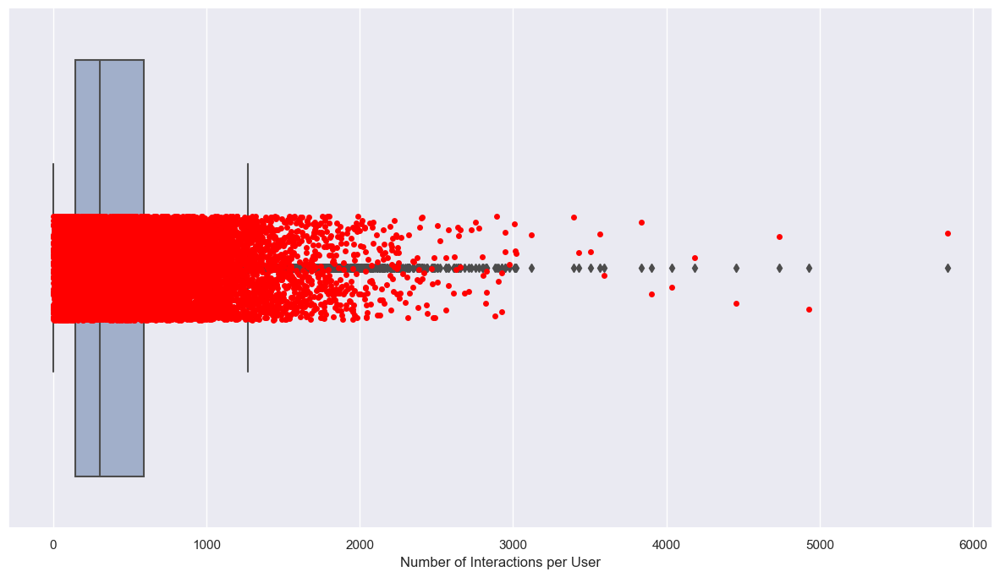

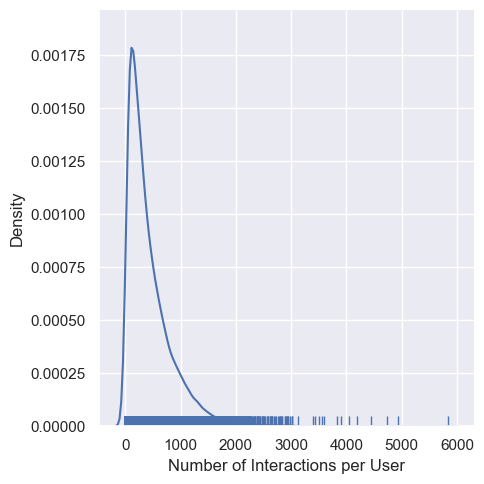

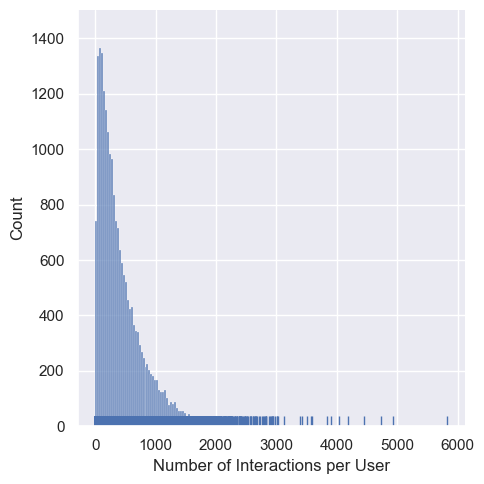

****************************************************************************************************
****************************************************************************************************
----------------------------------------------------------------------------------------------------
Number of Unique Topics per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per User: 1.1122512289409632
median: Number of Unique Topics per User: 1.0
max: Number of Unique Topics per User: 4
min: Number of Unique Topics per User: 1
std: Number of Unique Topics per User: 0.330311699028704
iqr: Number of Unique Topics per User: 0.0


Plots:


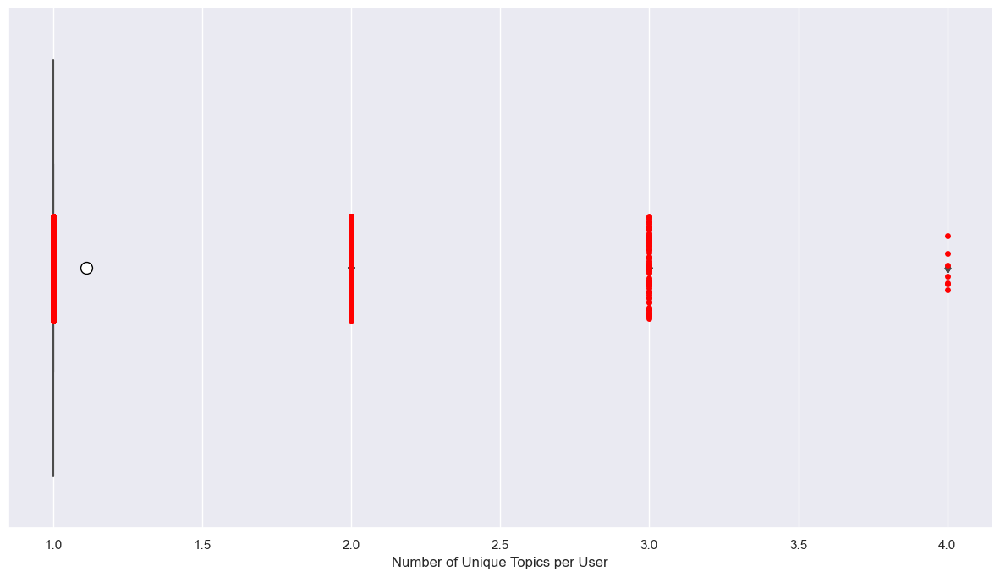

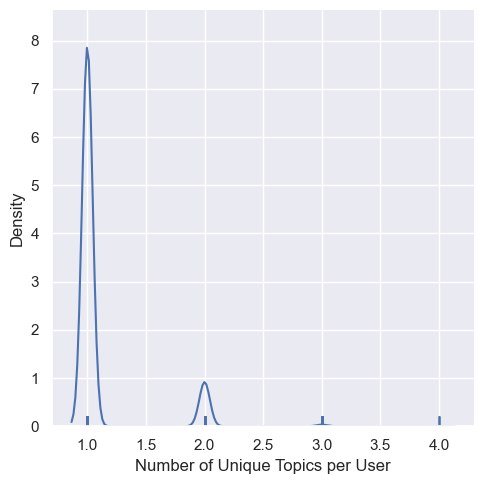

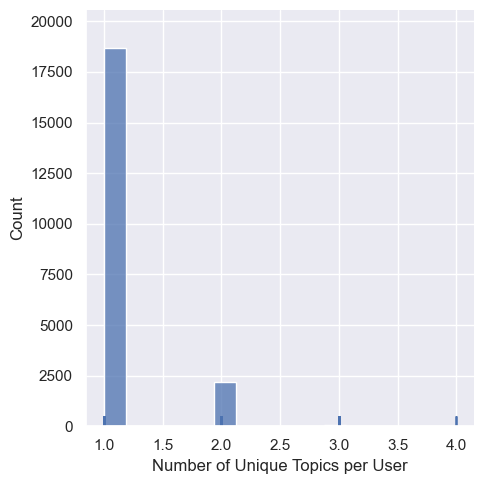

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per User: 87.0479644919582
median: Number of Unique Learning Resources per User: 70.0
max: Number of Unique Learning Resources per User: 579
min: Number of Unique Learning Resources per User: 1
std: Number of Unique Learning Resources per User: 62.32740230483077
iqr: Number of Unique Learning Resources per User: 77.0


Plots:


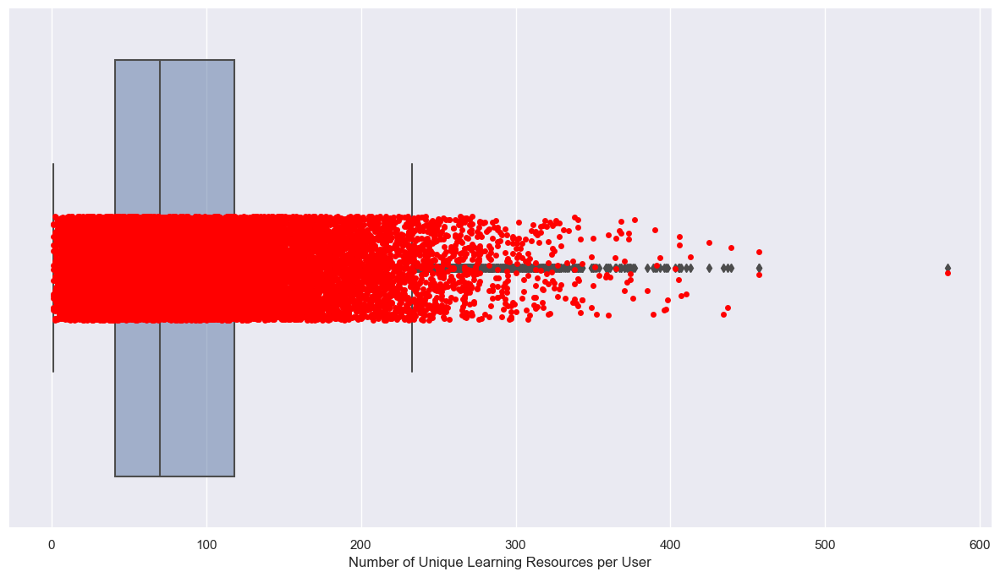

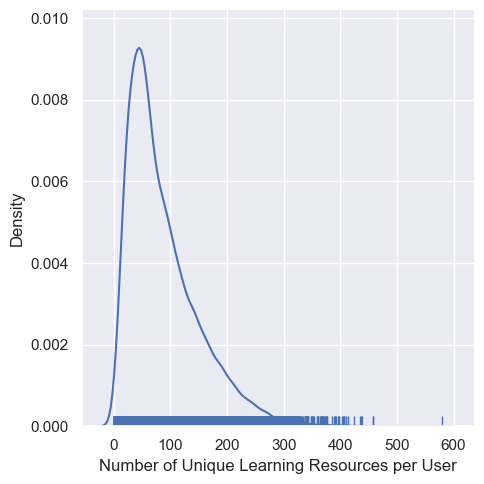

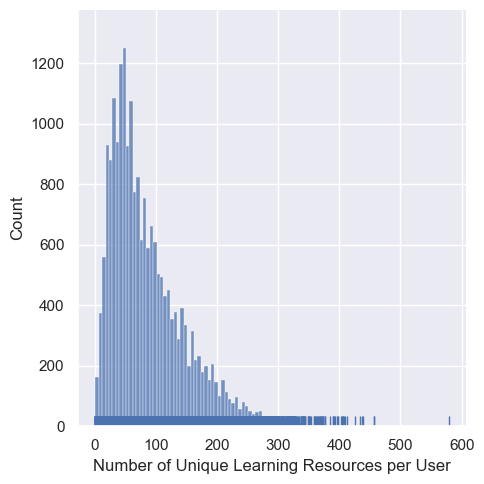

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Topic: 1226.578947368421
median: Number of Unique Users per Topic: 1355.0
max: Number of Unique Users per Topic: 1989
min: Number of Unique Users per Topic: 339
std: Number of Unique Users per Topic: 484.45241892143594
iqr: Number of Unique Users per Topic: 607.5


Plots:


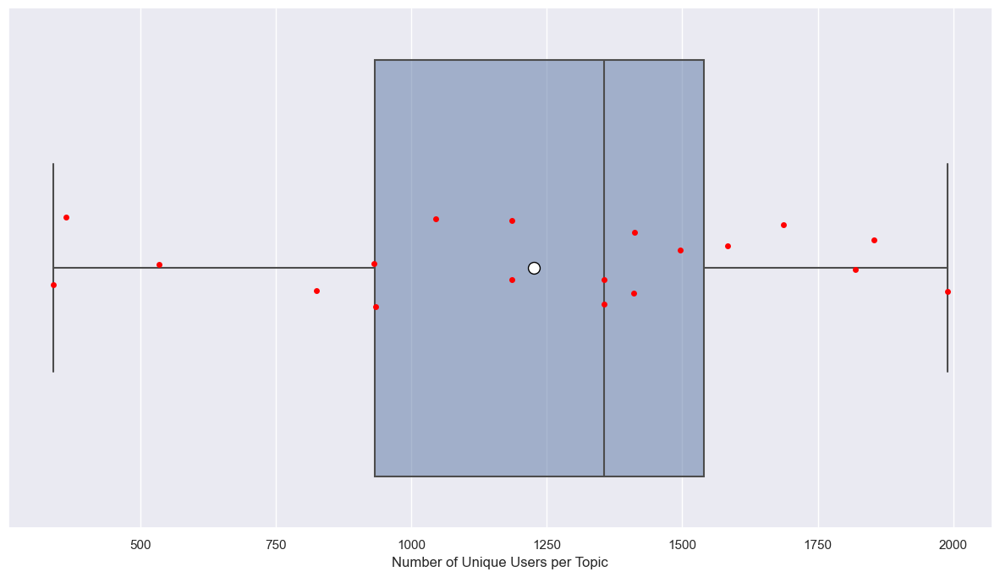

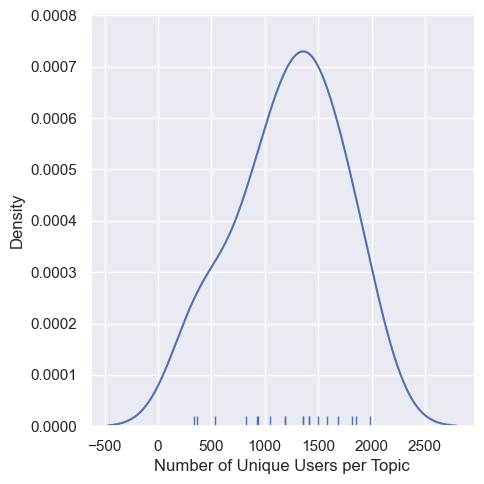

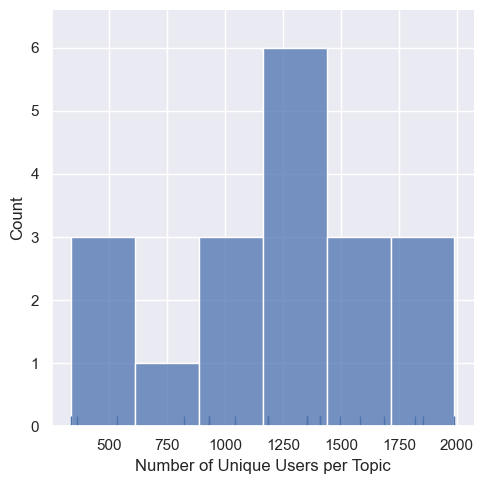

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per Topic: 309.10526315789474
median: Number of Unique Learning Resources per Topic: 315.0
max: Number of Unique Learning Resources per Topic: 526
min: Number of Unique Learning Resources per Topic: 104
std: Number of Unique Learning Resources per Topic: 142.61443542987666
iqr: Number of Unique Learning Resources per Topic: 246.5


Plots:


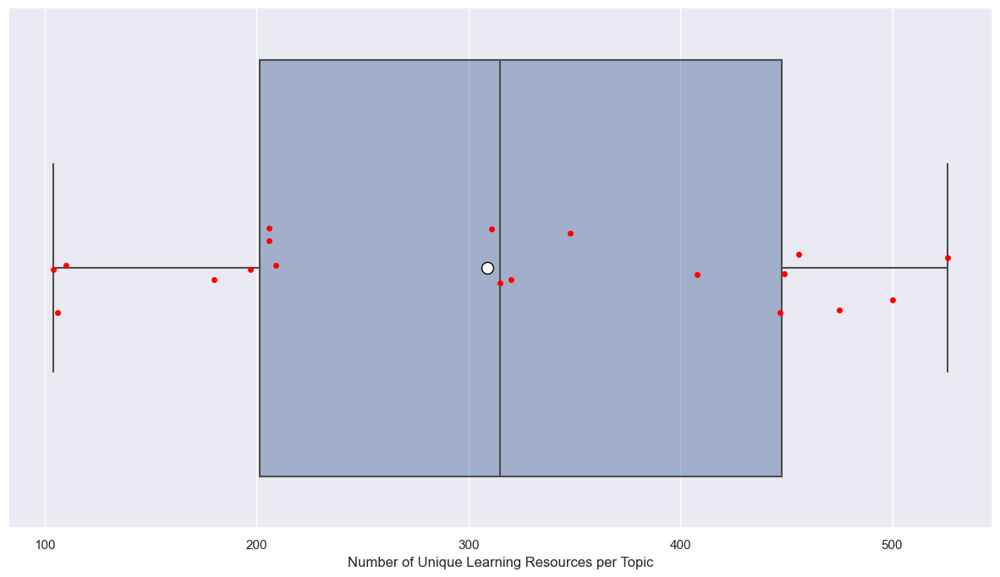

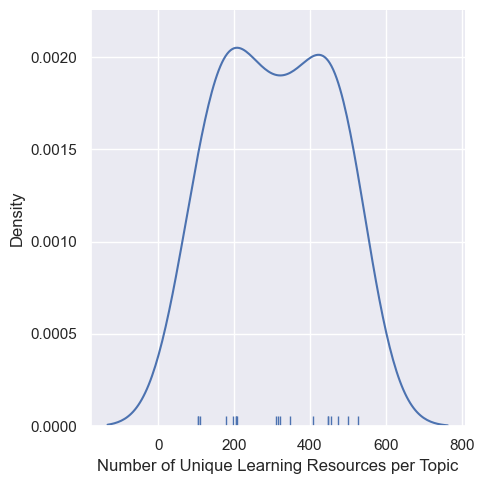

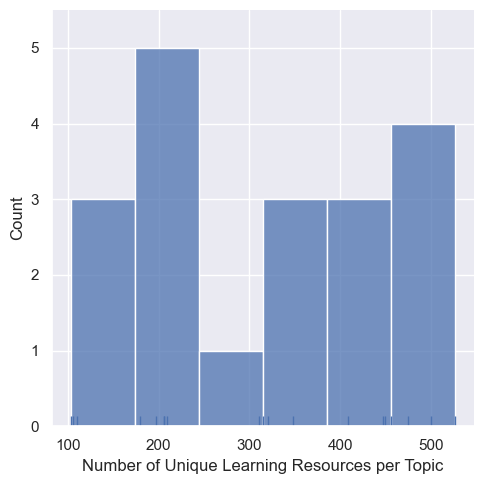

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Learning Resource: 310.5595096202963
median: Number of Unique Users per Learning Resource: 152.0
max: Number of Unique Users per Learning Resource: 1989
min: Number of Unique Users per Learning Resource: 1
std: Number of Unique Users per Learning Resource: 375.17633534661957
iqr: Number of Unique Users per Learning Resource: 439.0


Plots:


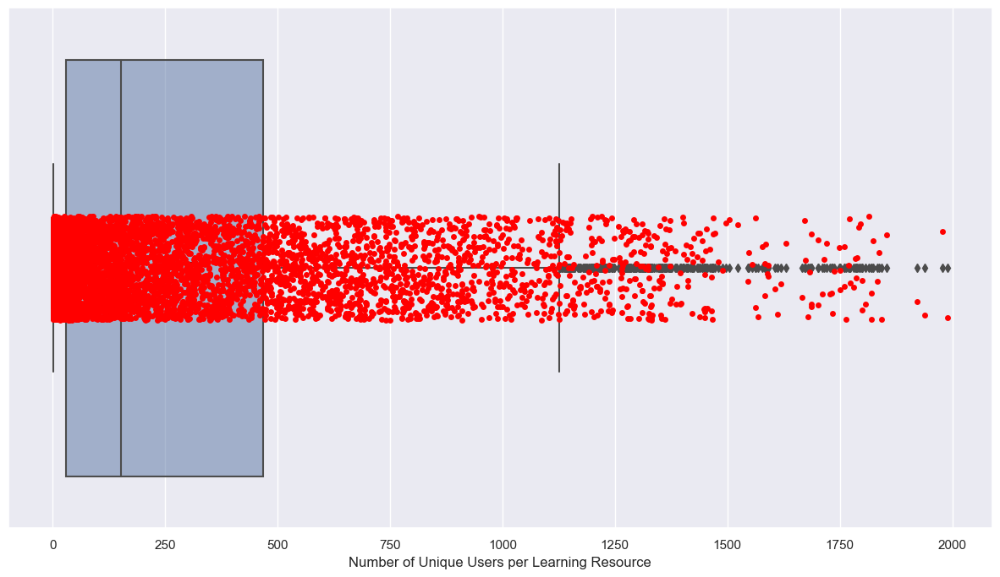

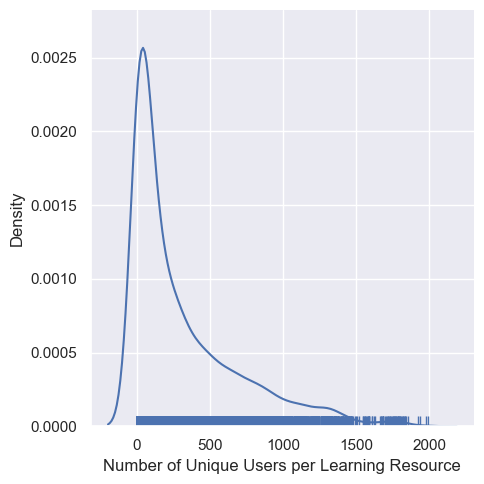

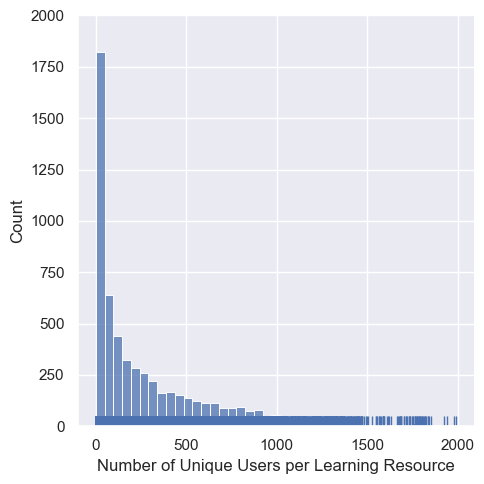

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Topics per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per Learning Resource: 1.0
median: Number of Unique Topics per Learning Resource: 1.0
max: Number of Unique Topics per Learning Resource: 1
min: Number of Unique Topics per Learning Resource: 1
std: Number of Unique Topics per Learning Resource: 0.0
iqr: Number of Unique Topics per Learning Resource: 0.0


Plots:


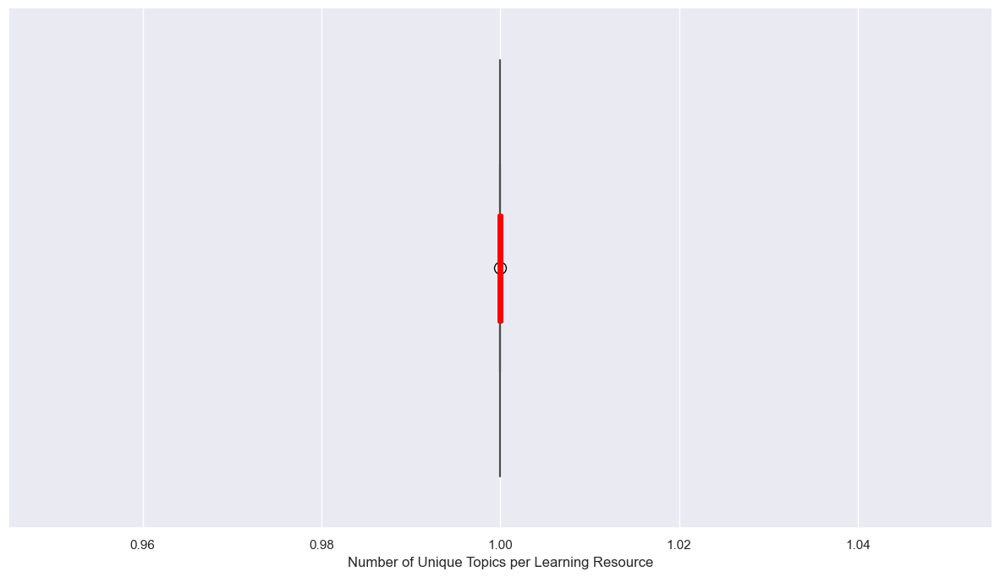

/Users/stefanschmerda/stefan/code/repos/know_center/ddia_dataset_analysis/dataset_analysis/utilities/functions.py:1221: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  g = sns.displot(data=data,


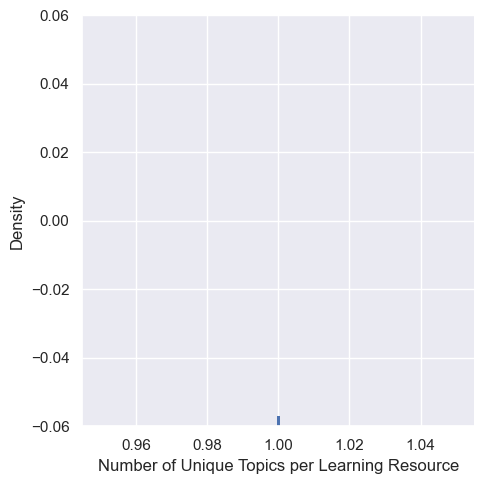

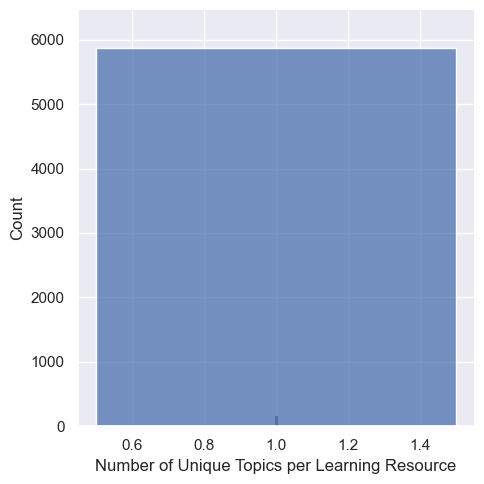

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per Topic for a User: 393.06591737062314
median of Mean Number of Interactions per Topic for a User: 283.0
max of Mean Number of Interactions per Topic for a User: 2947.0
min of Mean Number of Interactions per Topic for a User: 1.0
std of Mean Number of Interactions per Topic for a User: 358.72574563853493
iqr of Mean Number of Interactions per Topic for a User: 406.0

____________________________________________________________________________________________________

mean of Median Number of In

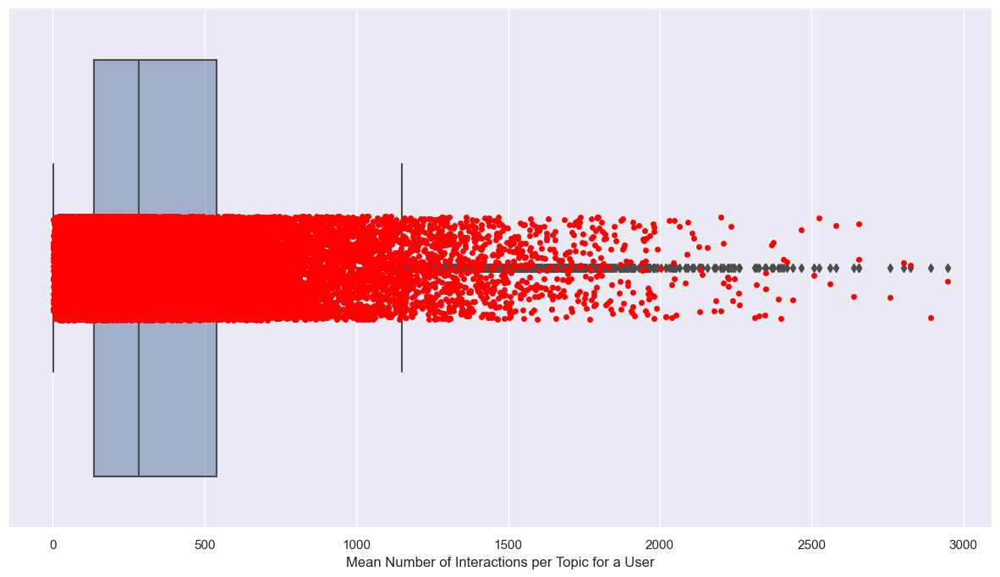

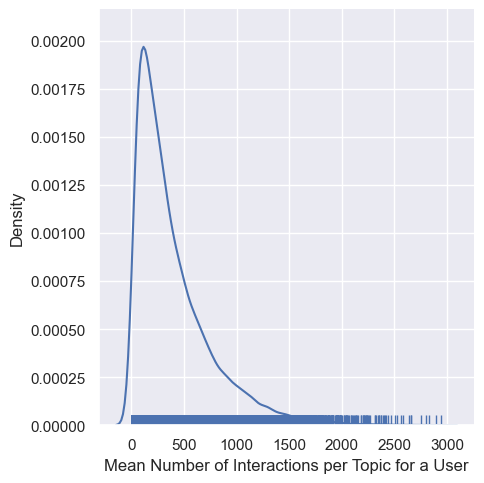

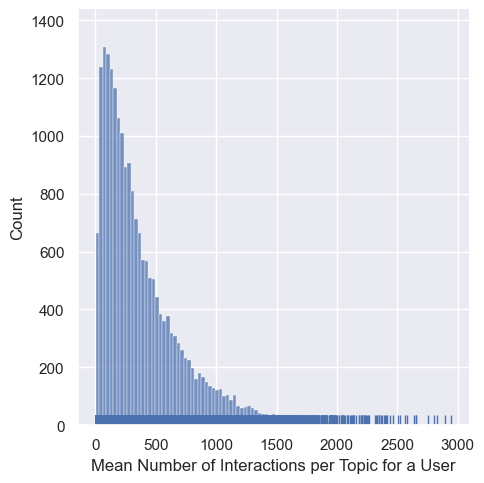



Median:


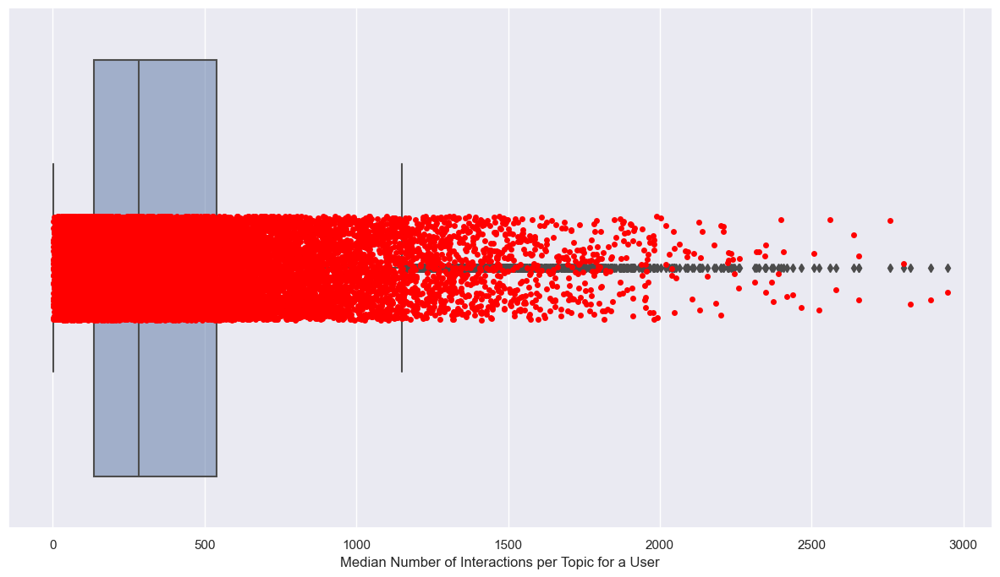

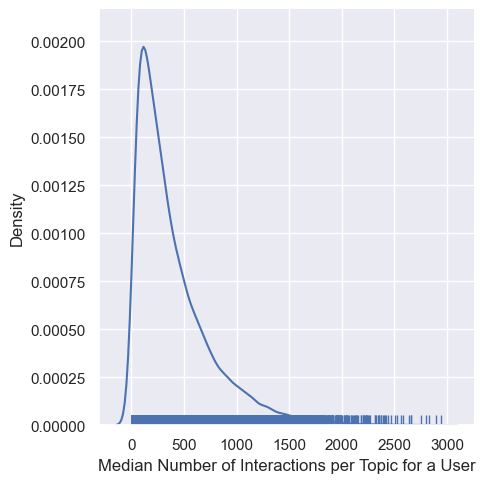

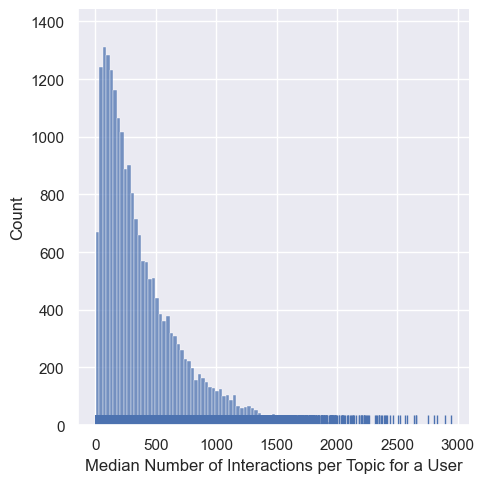

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per User for a Topic: 389.60016002871373
median of Mean Number of Interactions per User for a Topic: 372.8668098818475
max of Mean Number of Interactions per User for a Topic: 640.1408554572272
min of Mean Number of Interactions per User for a Topic: 188.64050632911392
std of Mean Number of Interactions per User for a Topic: 131.83777792045413
iqr of Mean Number of Interactions per User for a Topic: 154.1715537512718

_______________________________________________________________________________

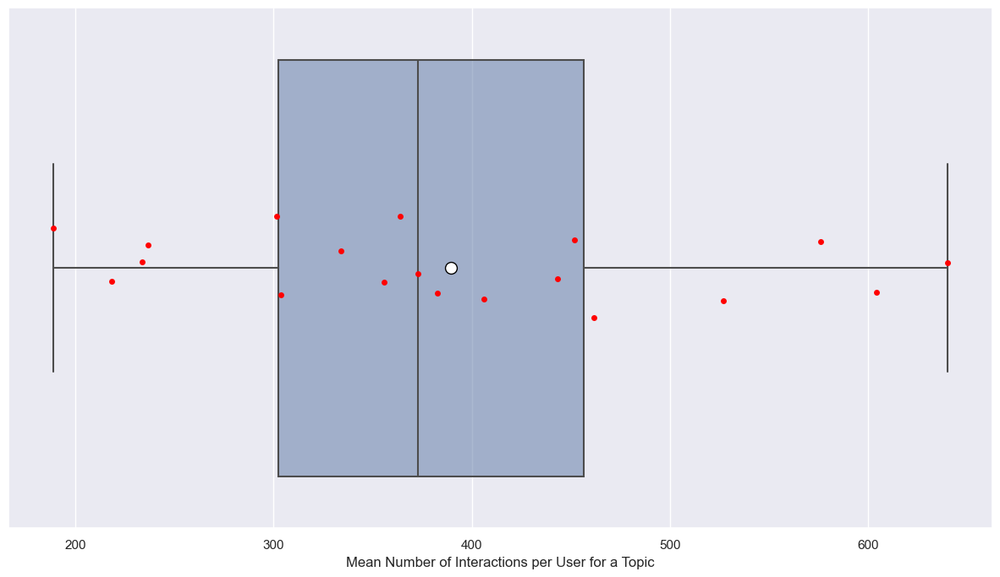

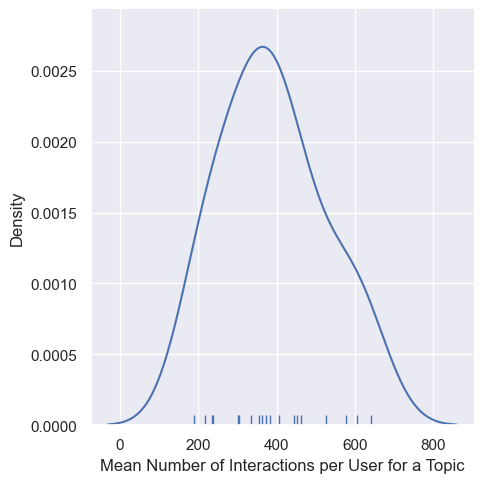

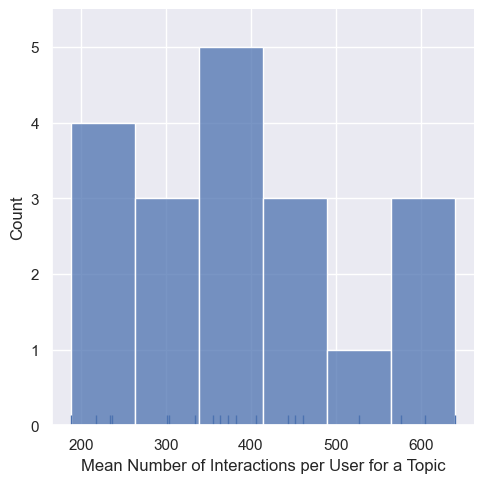



Median:


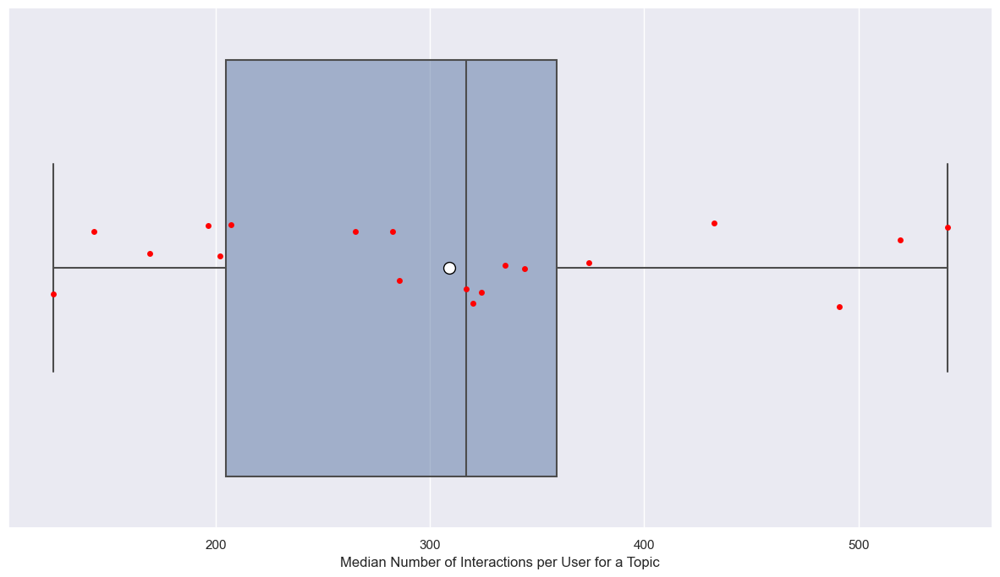

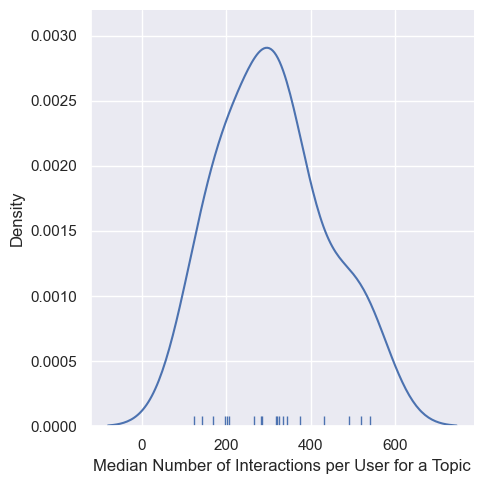

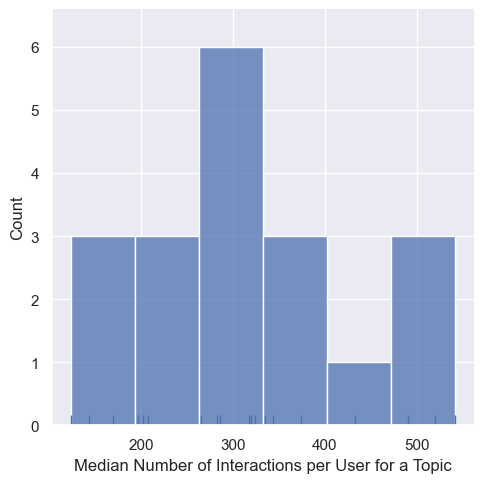

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per Topic for a User: 79.30471770152245
median of Mean Number of Unique Learning Resources per Topic for a User: 64.0
max of Mean Number of Unique Learning Resources per Topic for a User: 413.0
min of Mean Number of Unique Learning Resources per Topic for a User: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per Topic for a User: 79.27082040757887
median of Med

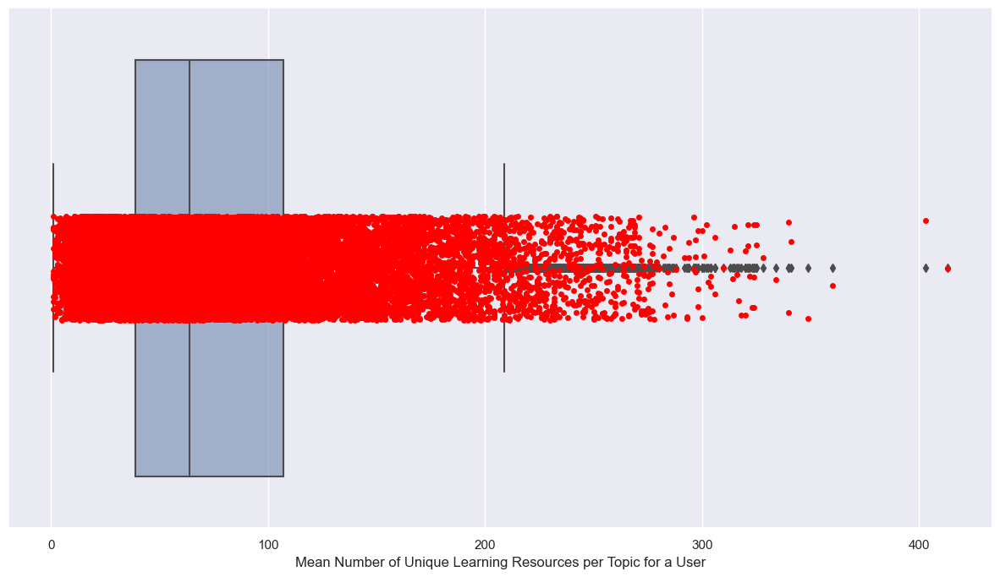

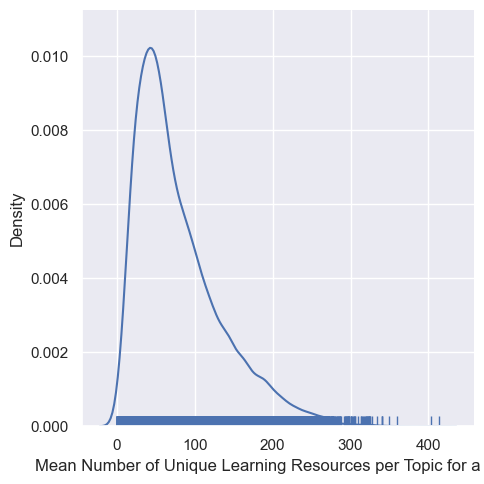

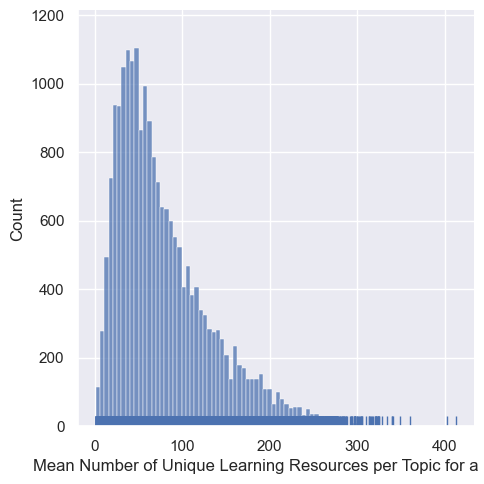



Median:


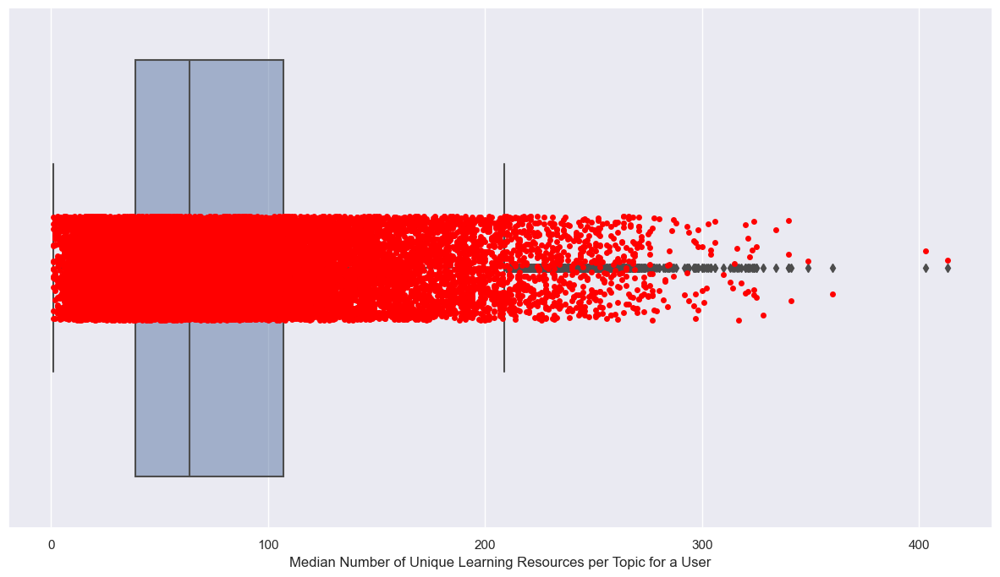

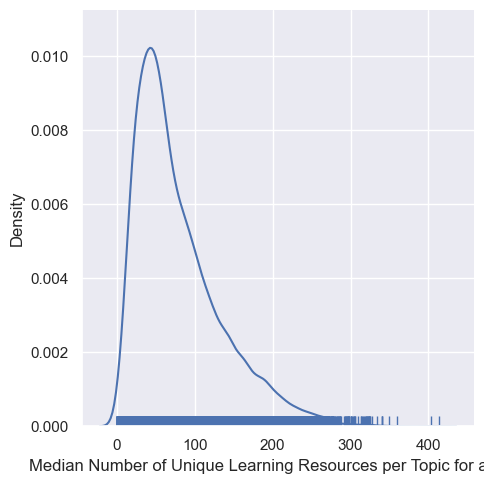

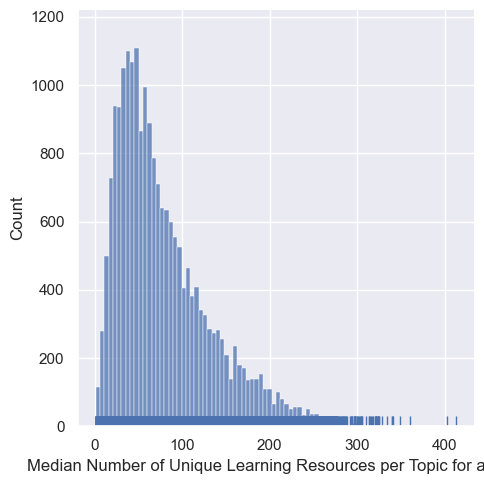

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per User for a Topic: 75.11517136082367
median of Mean Number of Unique Learning Resources per User for a Topic: 65.07638888888889
max of Mean Number of Unique Learning Resources per User for a Topic: 131.71238938053096
min of Mean Number of Unique Learning Resources per User for a Topic: 36.77637130801688

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per User for 

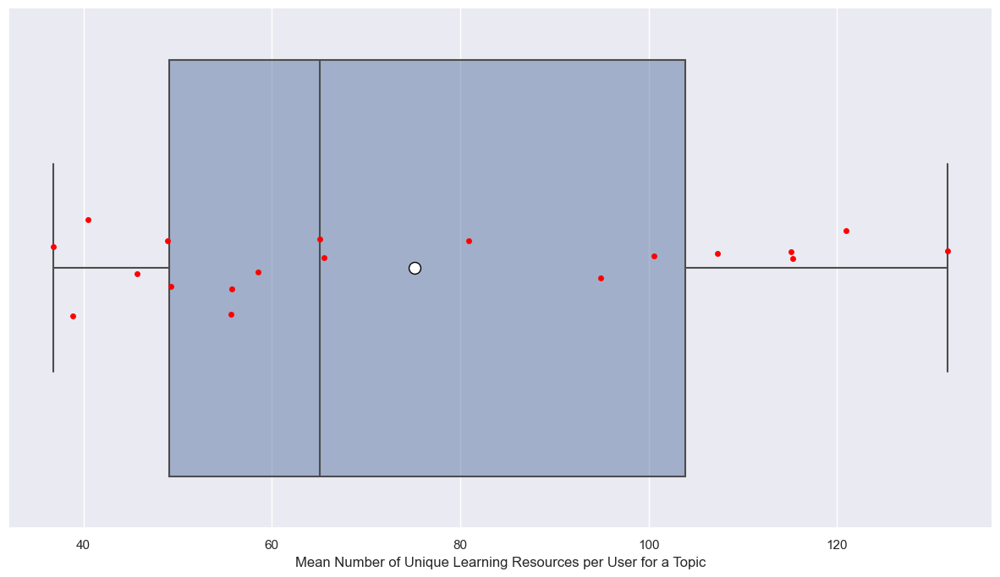

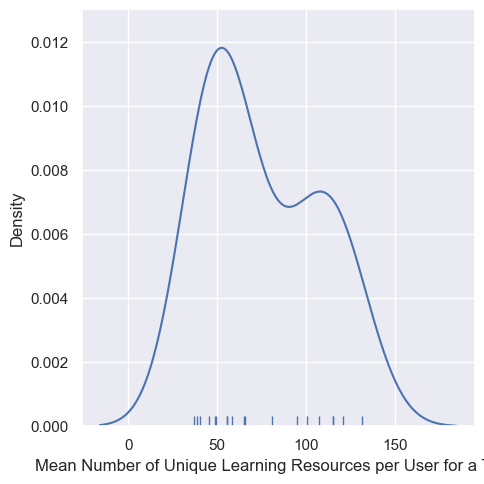

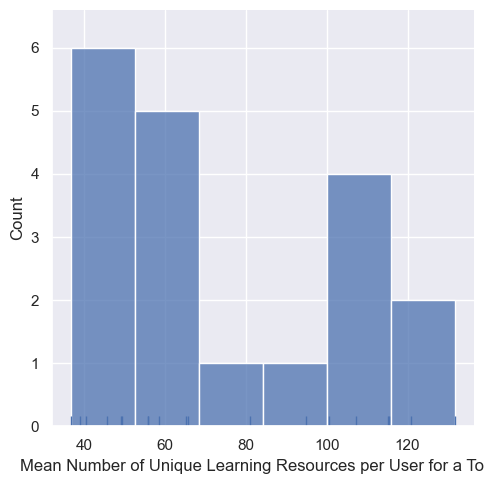



Median:


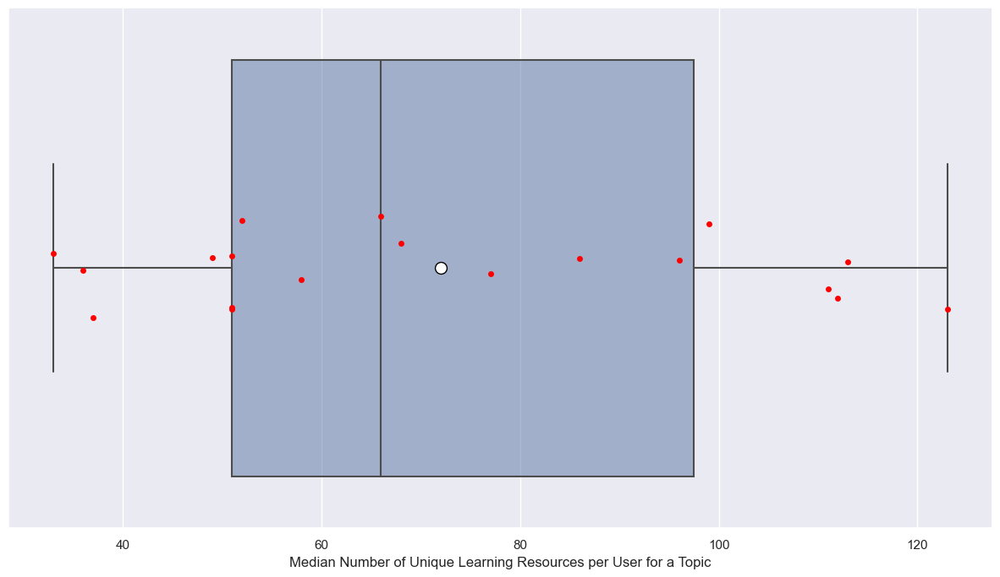

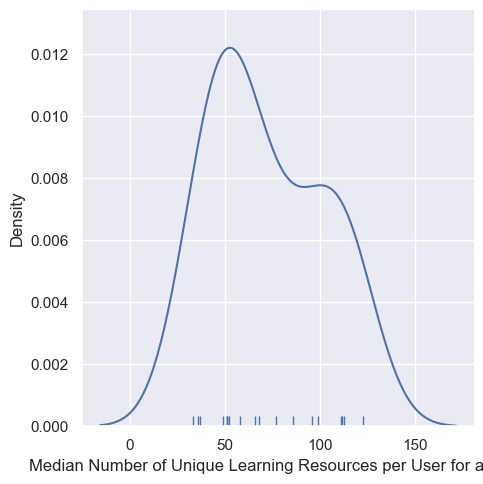

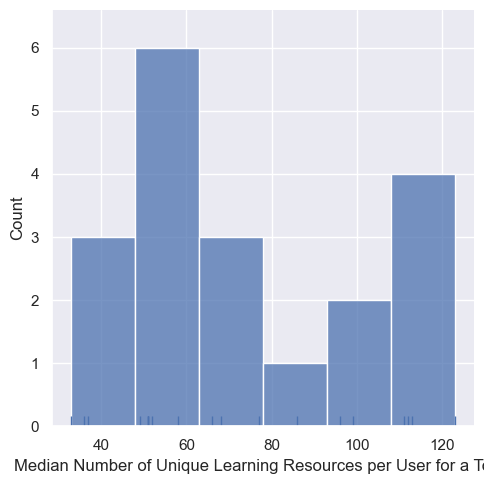

****************************************************************************************************
****************************************************************************************************
 


In [28]:
print_and_plot_group_user_learning_activity_relationship(interactions,
                                                         GROUP_FIELD_NAME_STR,
                                                         False)

## Unique Sequence Statistics

In [29]:
learning_activity_sequence_stats_per_group = return_learning_activity_sequence_stats_over_user_per_group(interactions,
                                                                                                         DATASET_NAME,
                                                                                                         GROUP_FIELD_NAME_STR, 
                                                                                                         USER_FIELD_NAME_STR, 
                                                                                                         LEARNING_ACTIVITY_FIELD_NAME_STR,
                                                                                                         TIMESTAMP_FIELD_NAME_STR)

In [30]:
pickle_write(learning_activity_sequence_stats_per_group,
             PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

### Unique Sequence Statistics

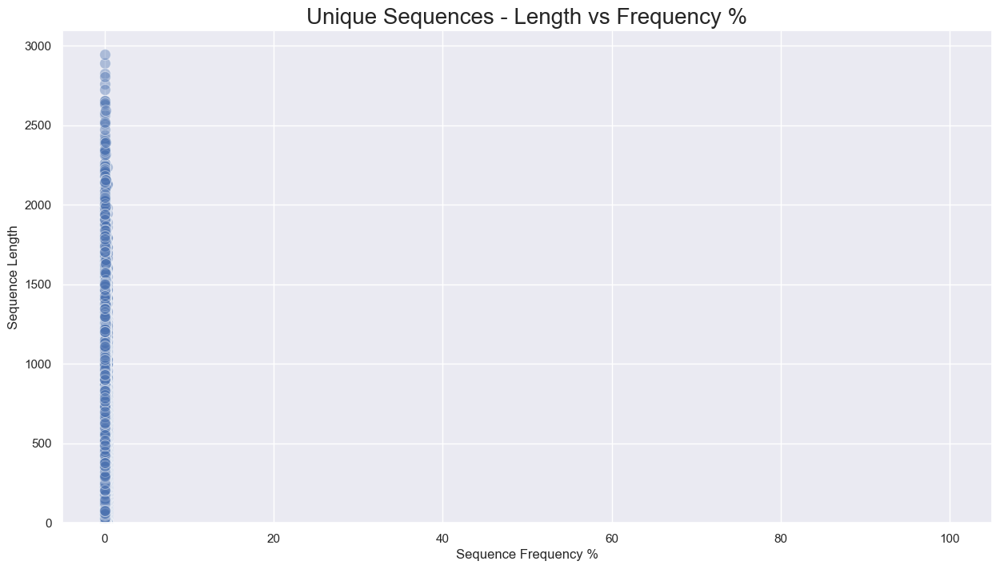

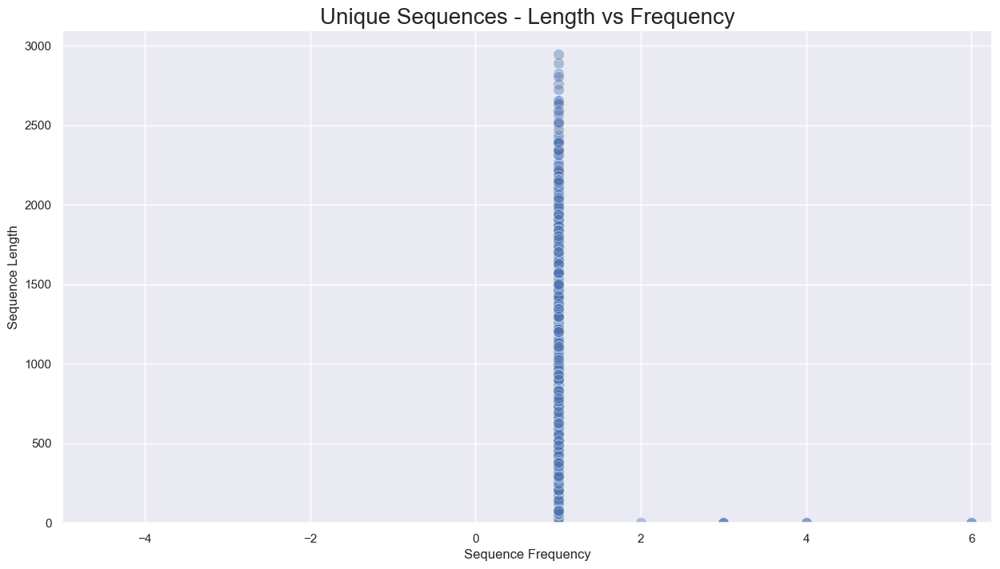

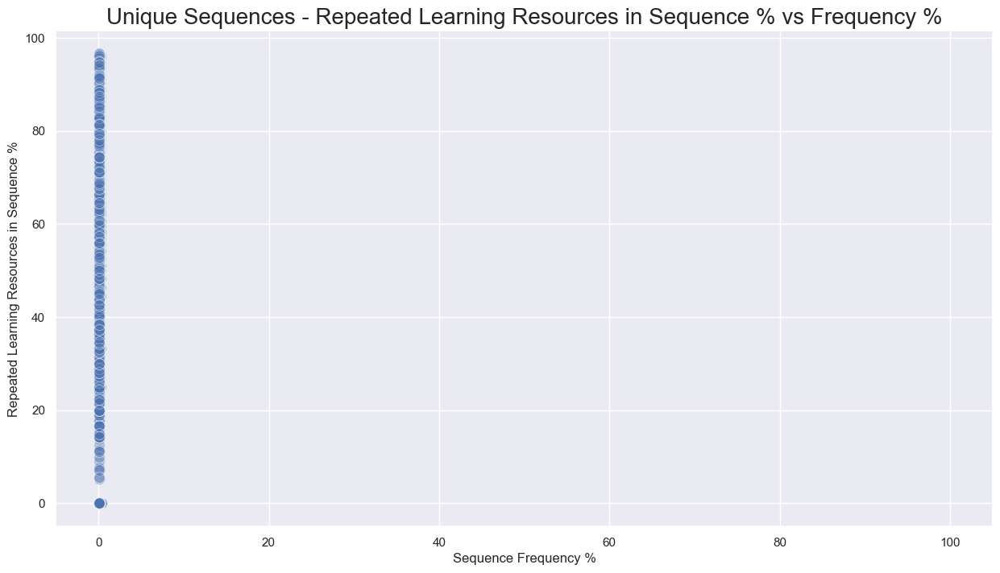

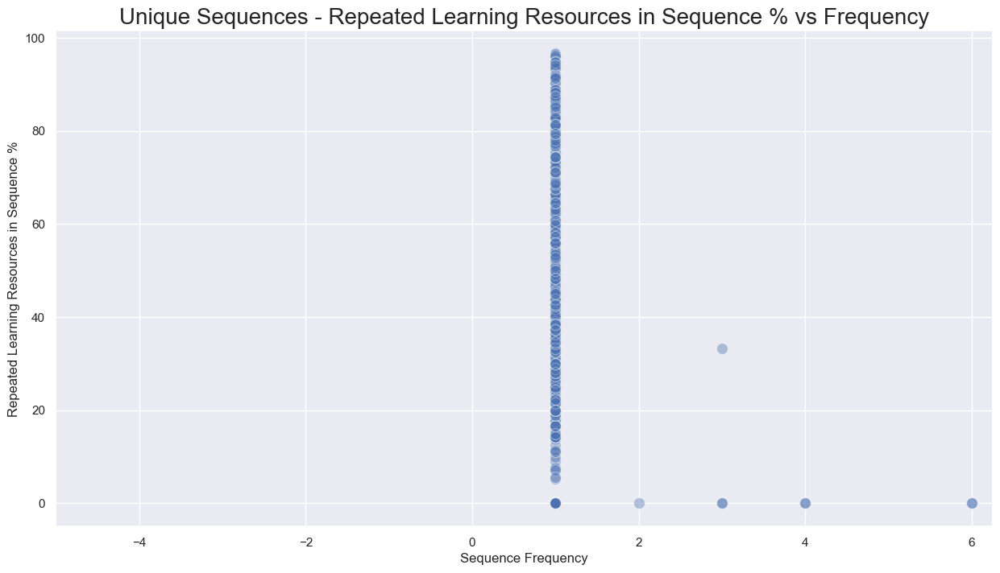

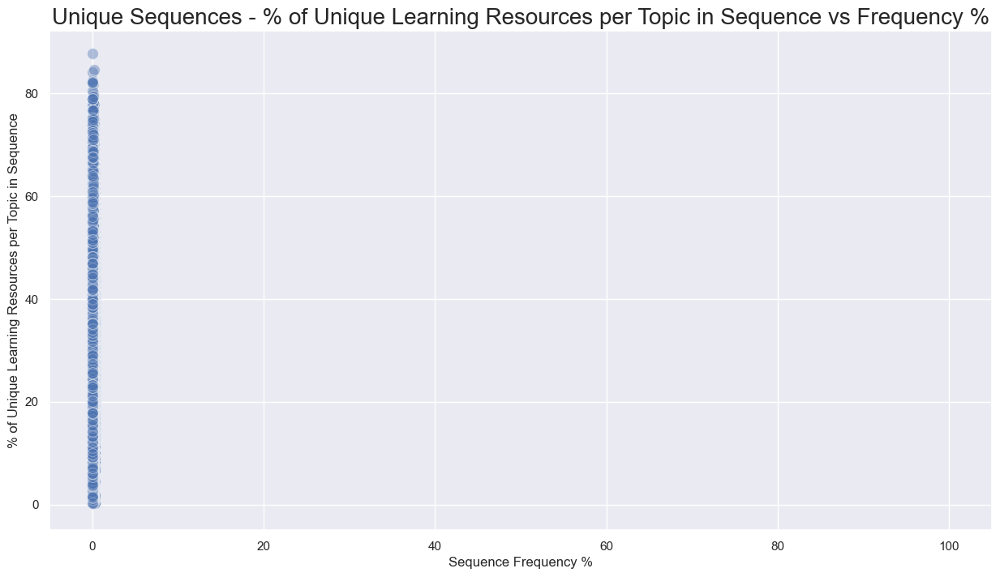

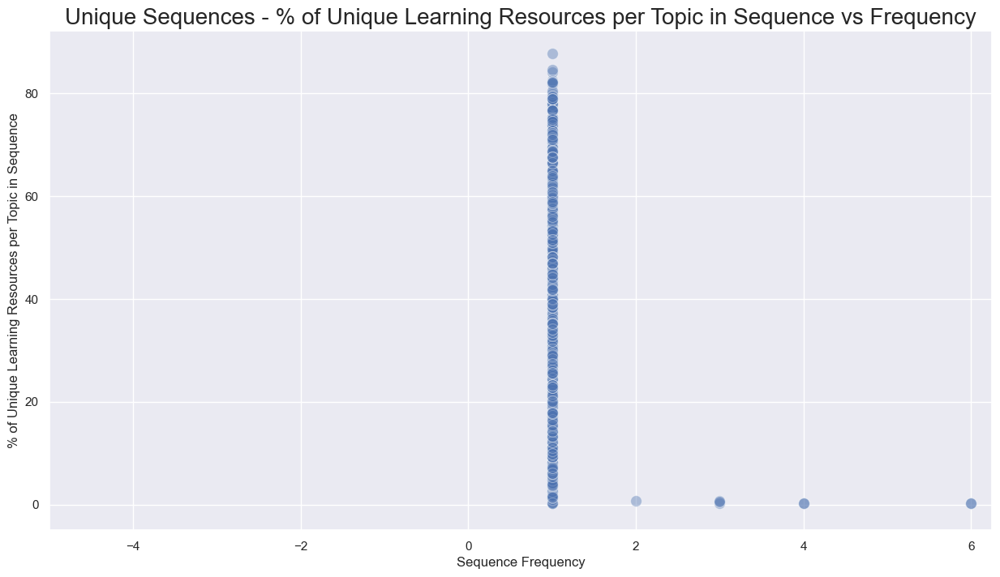

In [31]:
plot_sequence_stats(learning_activity_sequence_stats_per_group)

### Unique Sequence Statistics per Group

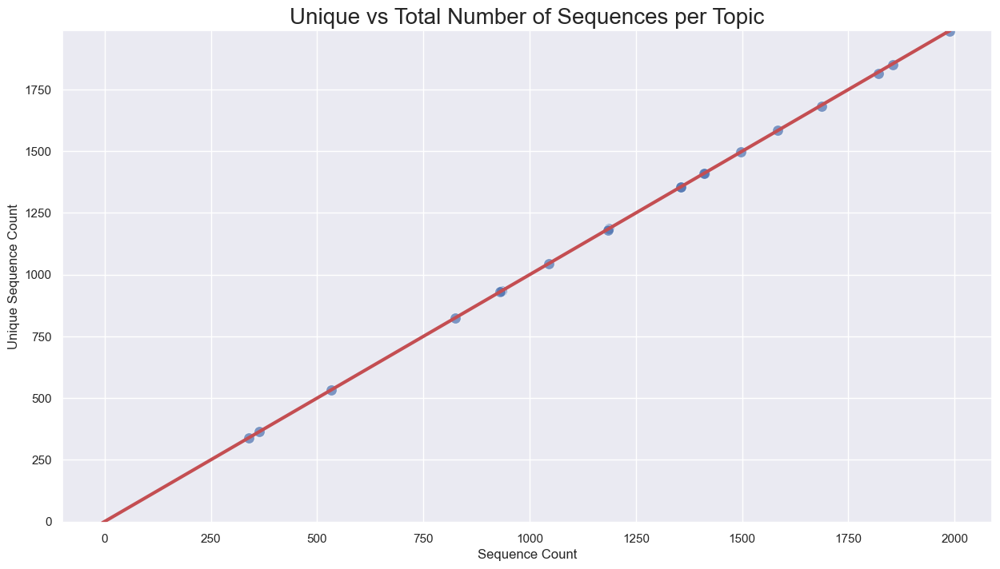

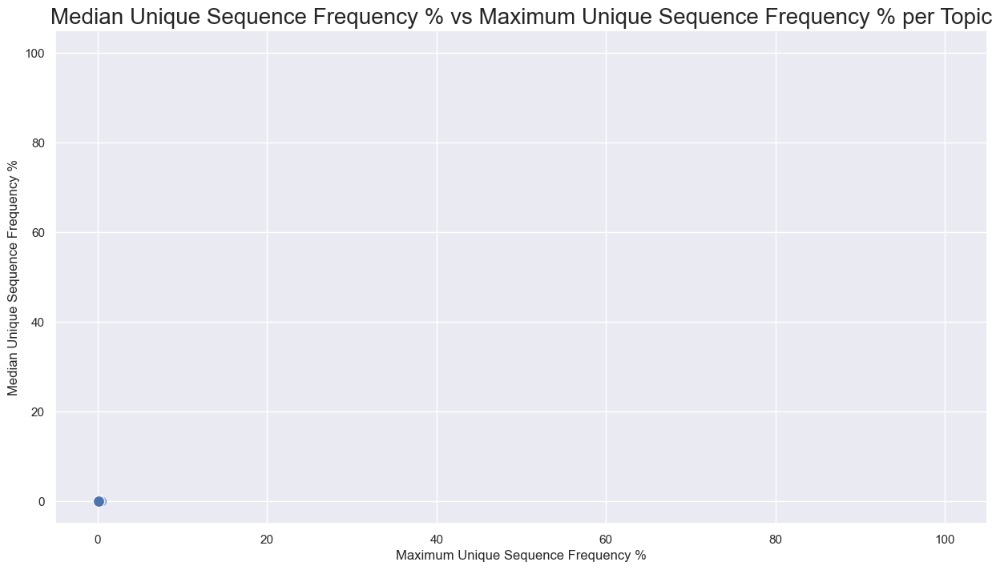

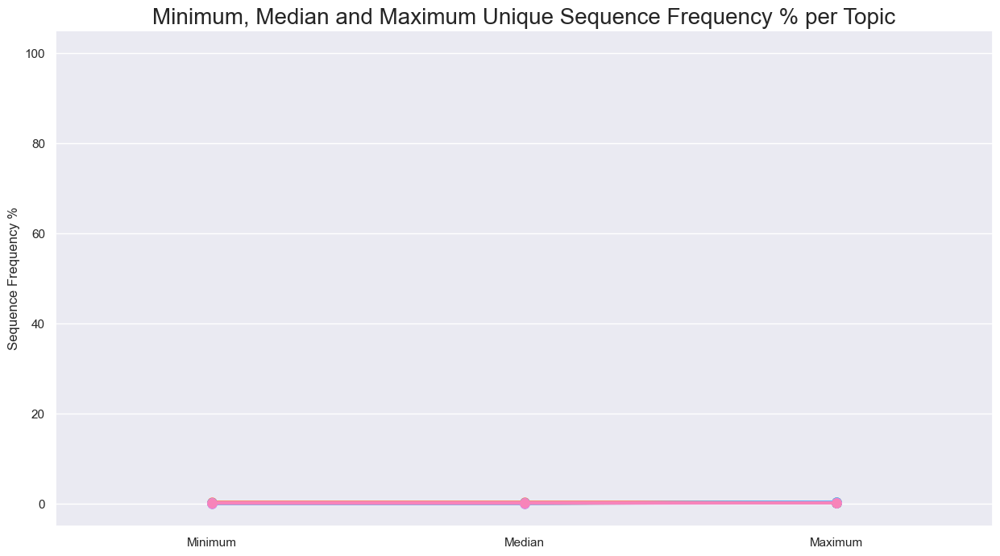

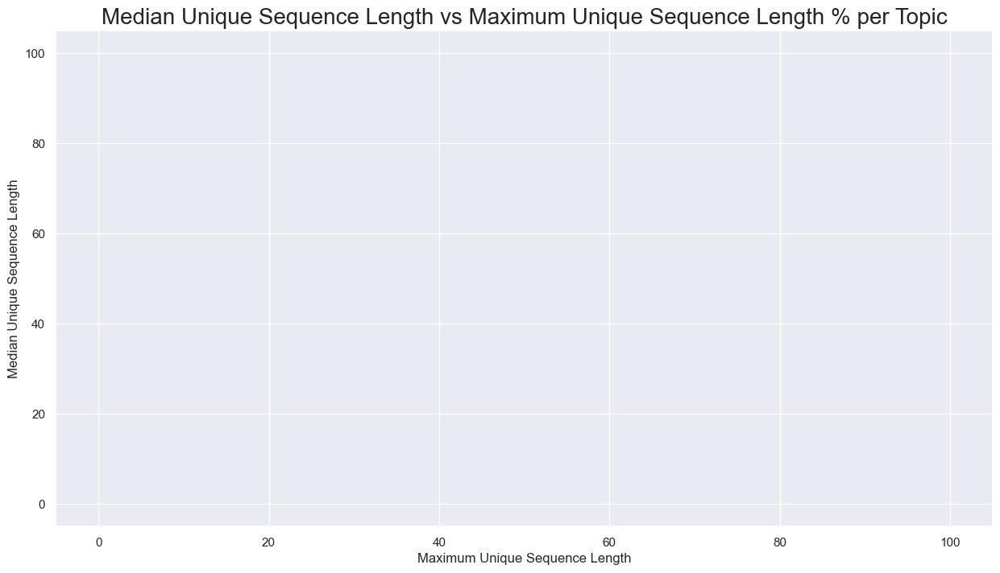

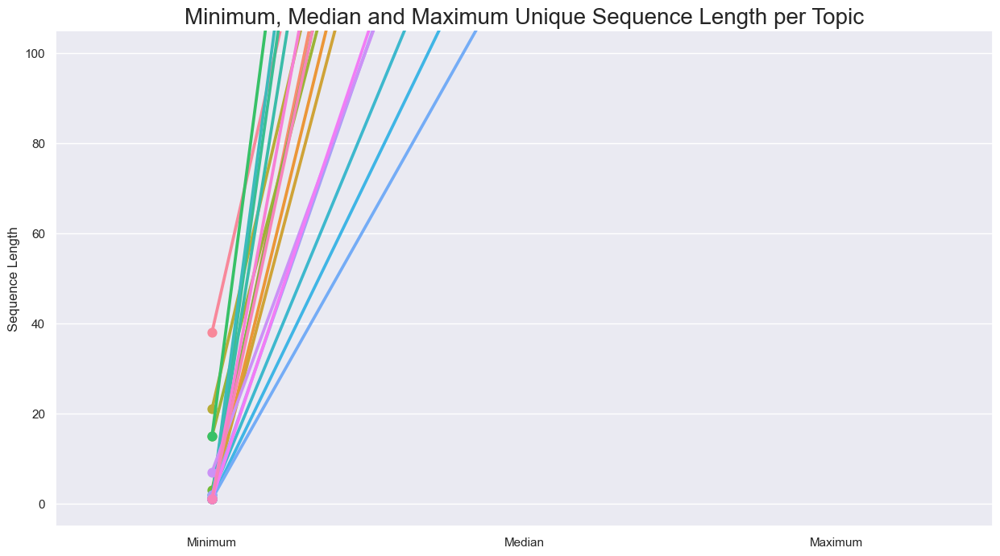

...

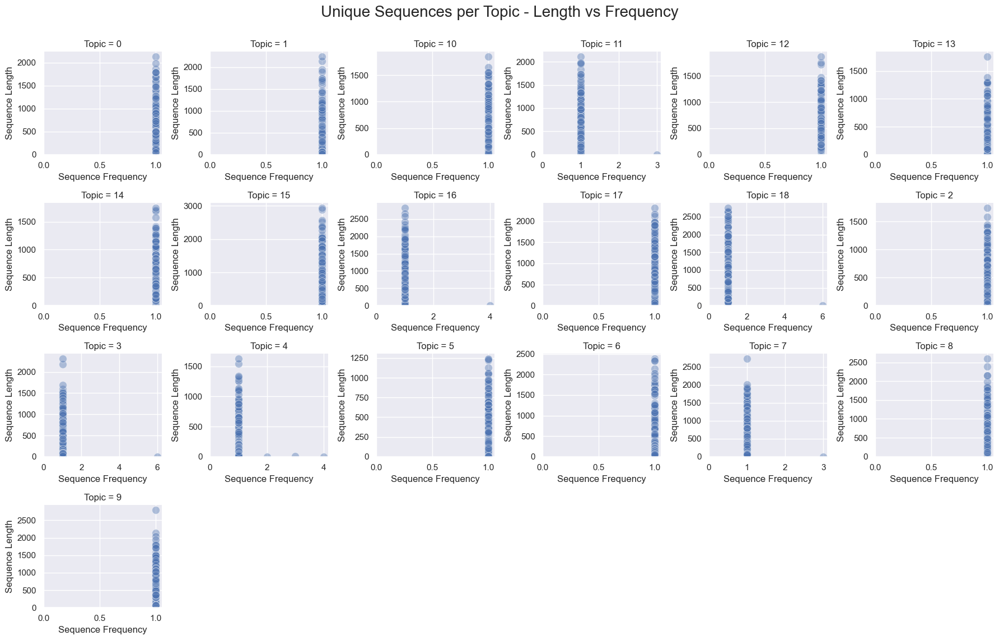

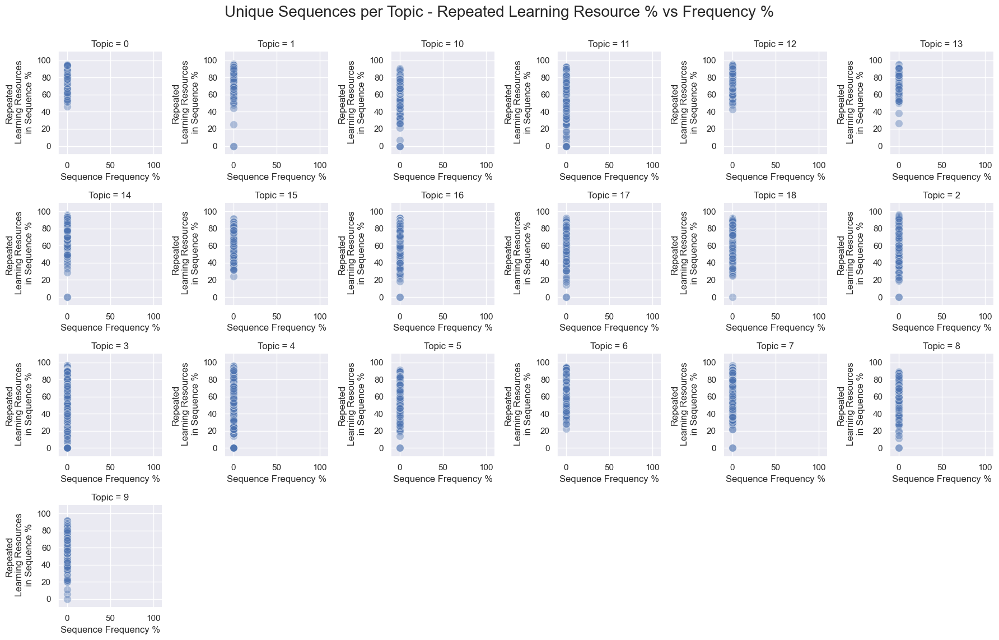

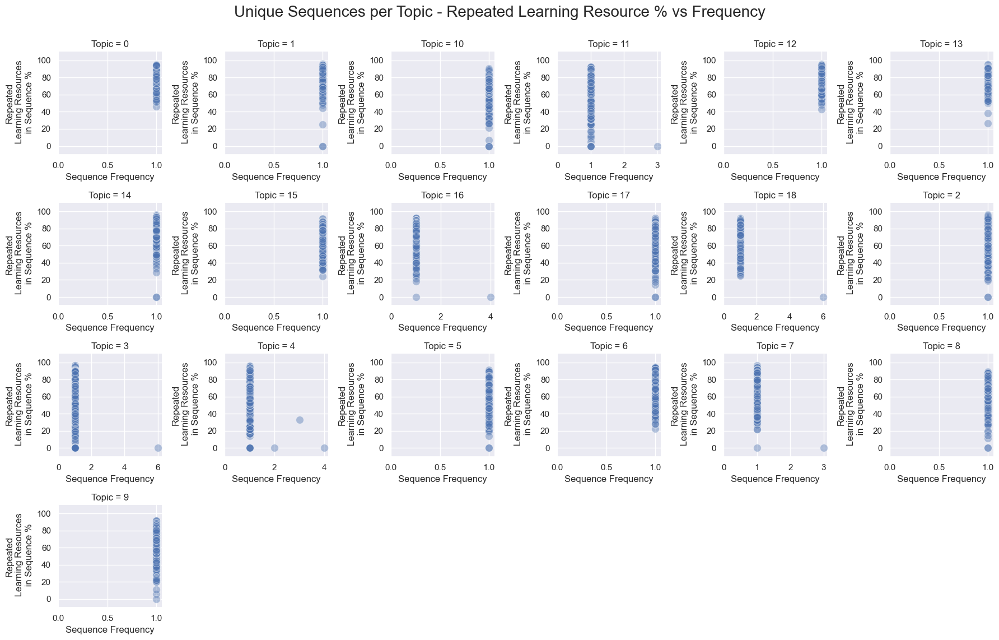

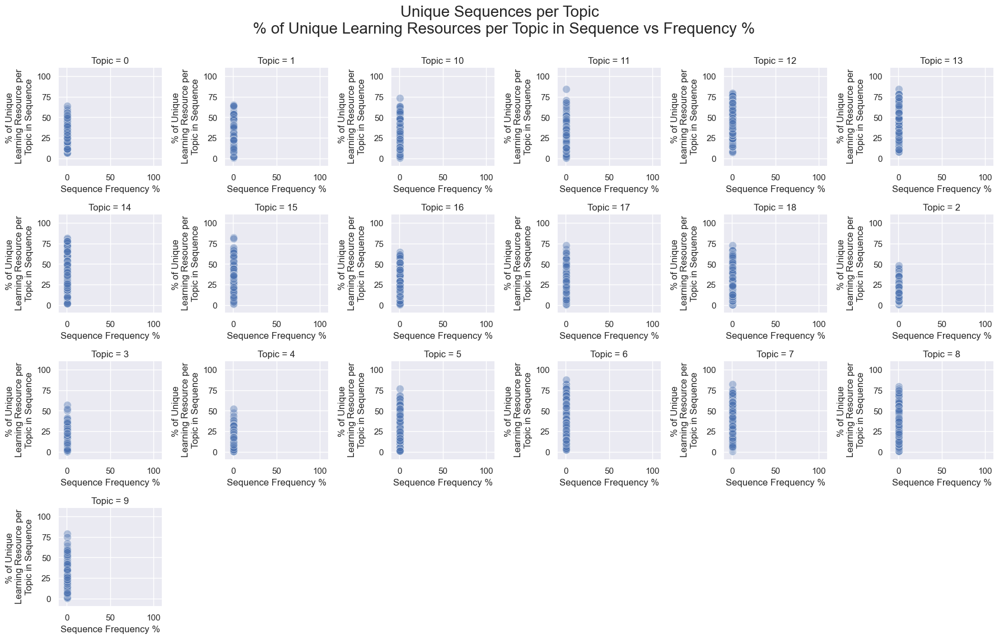

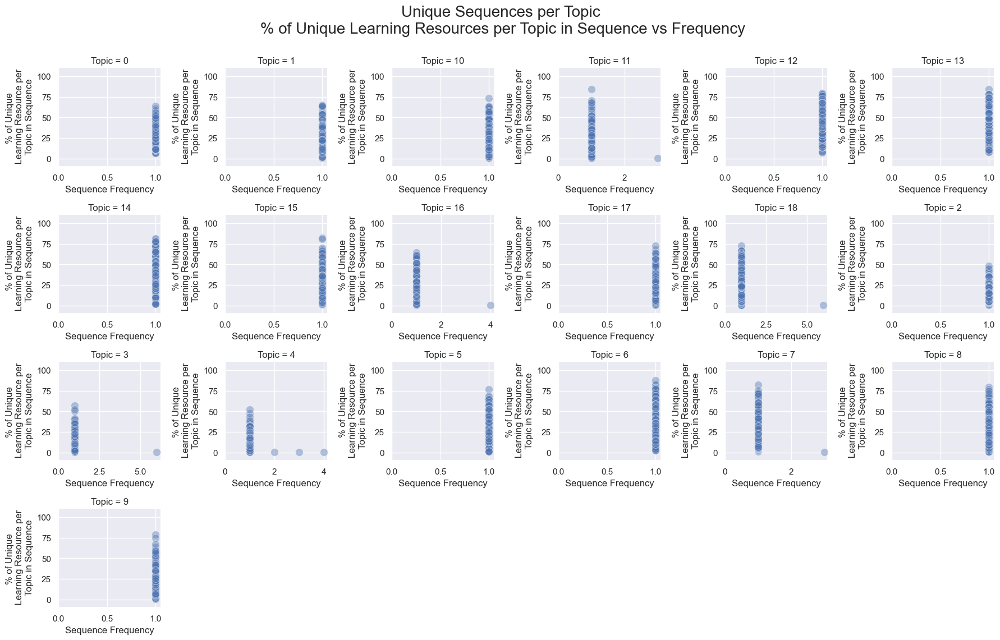

In [32]:
plot_sequence_stats_per_group(learning_activity_sequence_stats_per_group,
                              GROUP_FIELD_NAME_STR)

## Sequence Distance

In [33]:
seq_distances = calculate_sequence_distances(interactions, 
                                             USER_FIELD_NAME_STR, 
                                             GROUP_FIELD_NAME_STR, 
                                             LEARNING_ACTIVITY_FIELD_NAME_STR, 
                                             SEQUENCE_ID_FIELD_NAME_STR)

--------------------
Topic-Field Available:
Calulate Sequence Distances for each Topic
--------------------
--------------------------------------------------
Total number of Topic: 19
--------------------------------------------------
--------------------------------------------------
Final number of Topics: 19
Final number of Users: 20953
Final number of interactions: 9060962
--------------------------------------------------


100%|██████████| 19/19 [1:10:28<00:00, 222.53s/it]

--------------------------------------------------
Duration in seconds: 4237.926194190979
--------------------------------------------------


In [34]:
pickle_write(seq_distances,
             PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

100%|██████████| 19/19 [00:01<00:00, 17.34it/s]


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


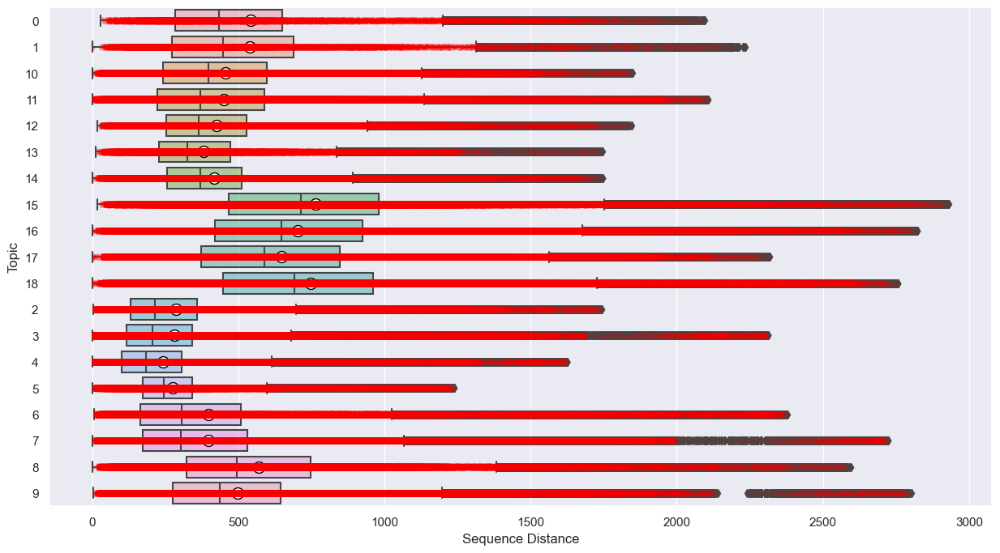

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


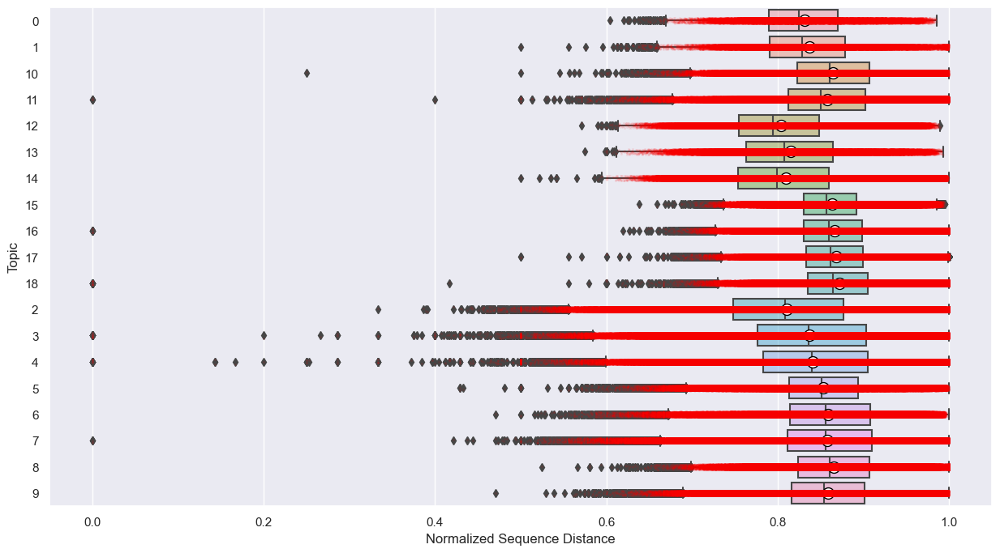

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


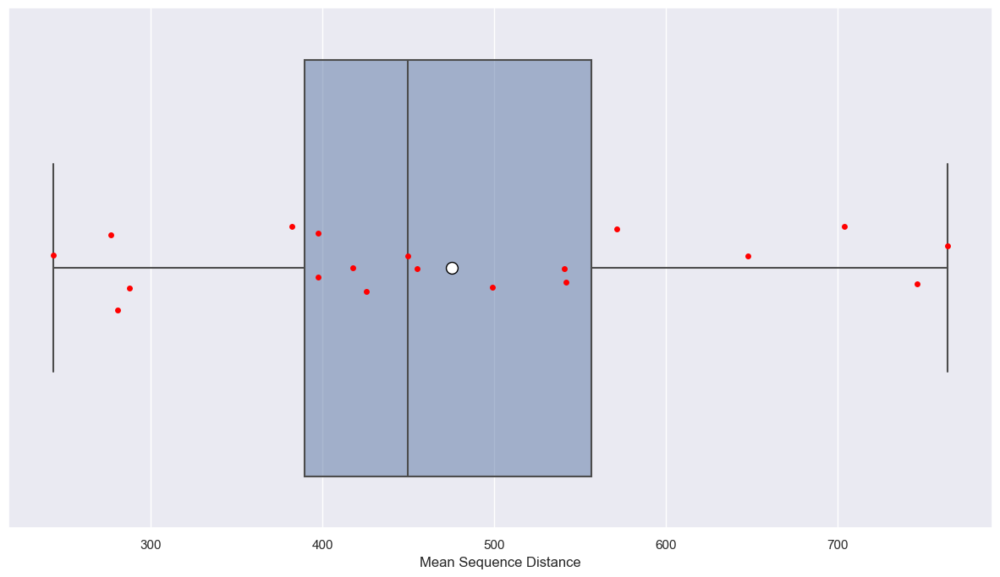

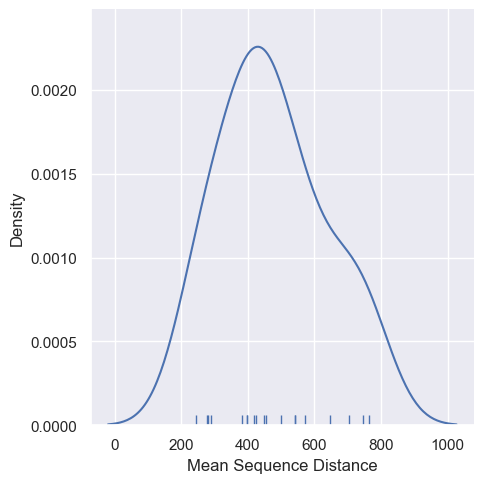

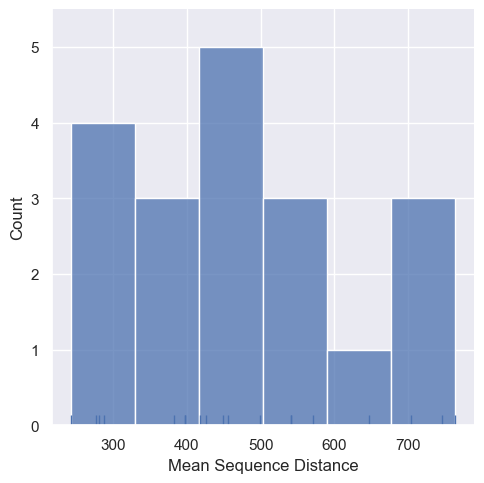

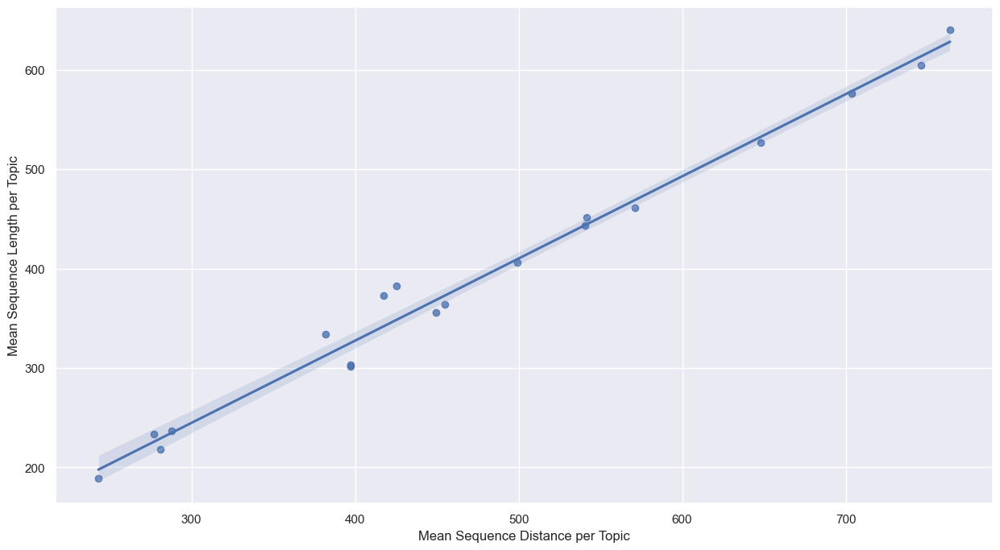

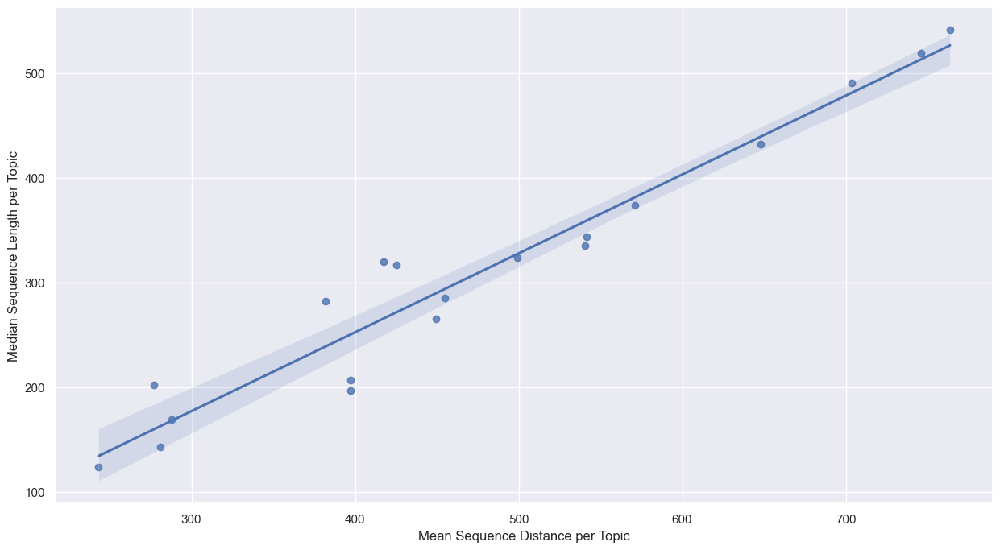

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


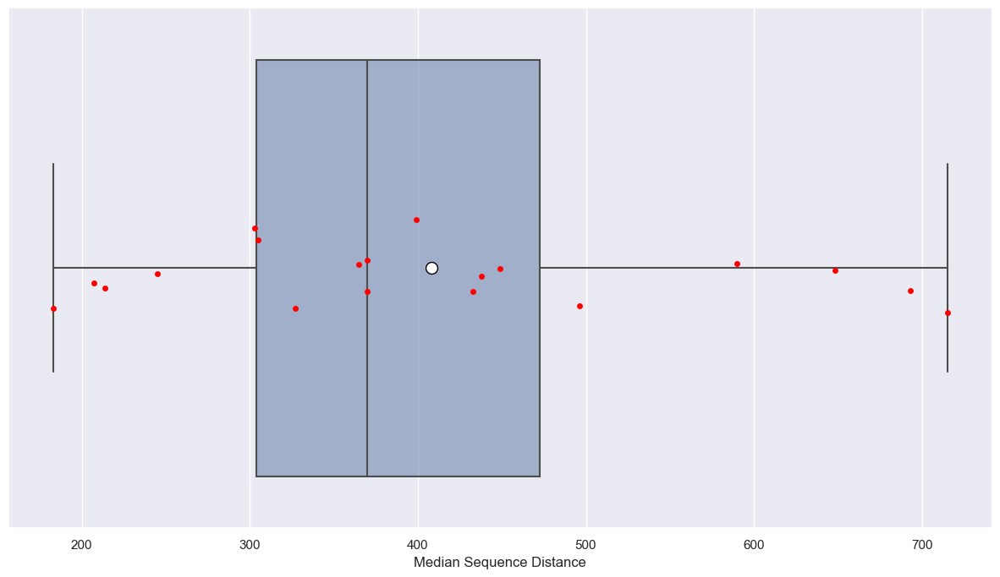

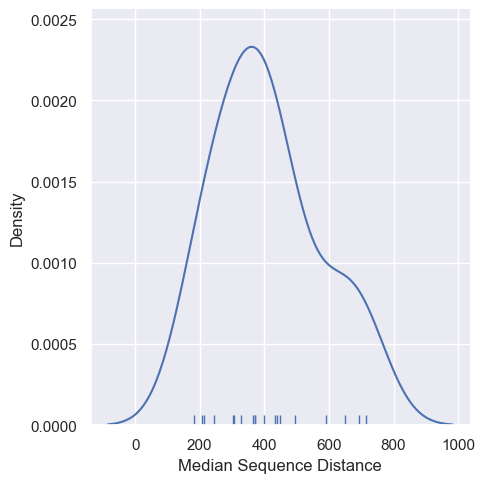

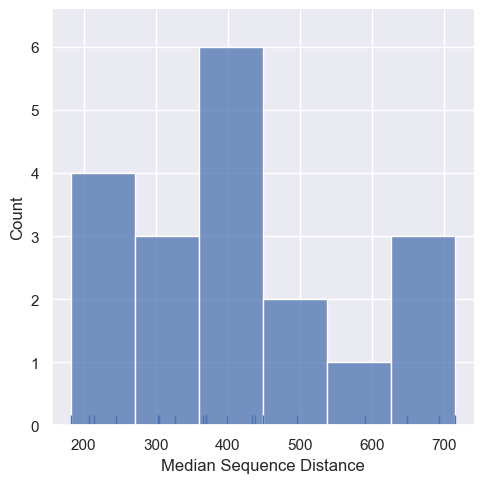

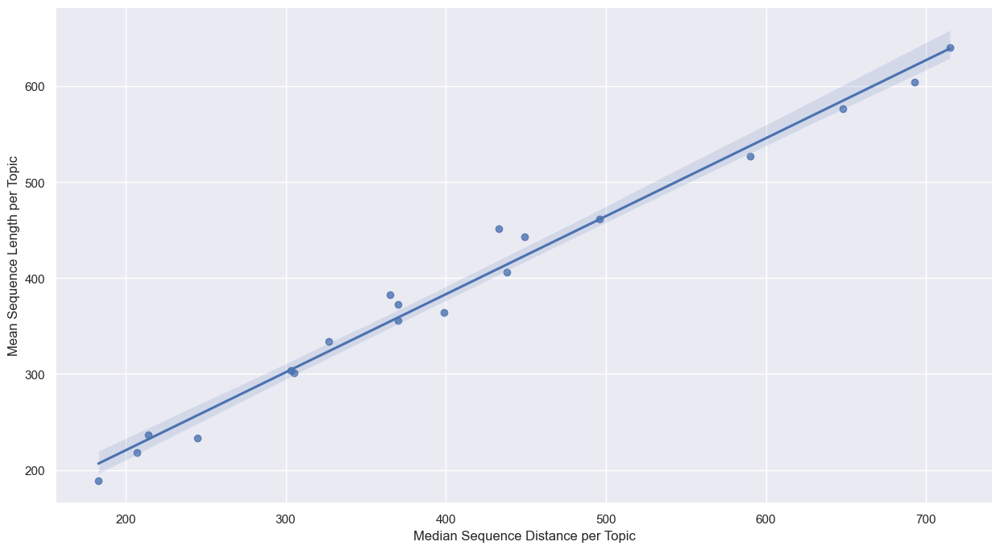

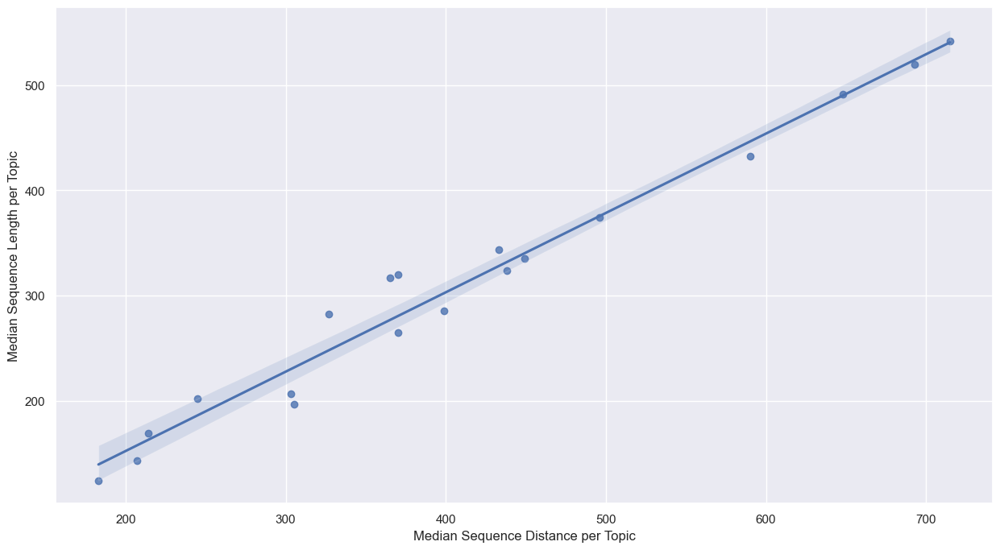

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


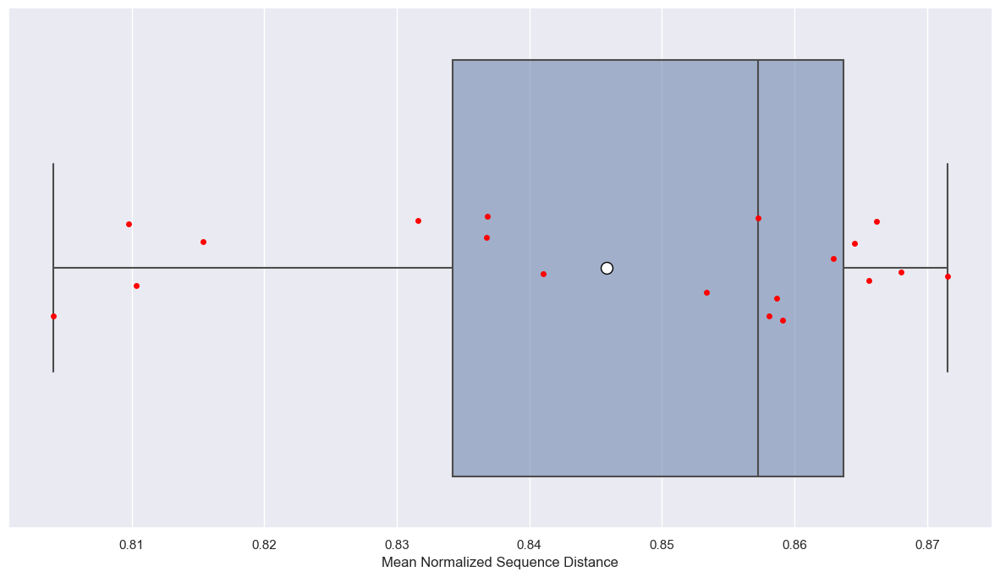

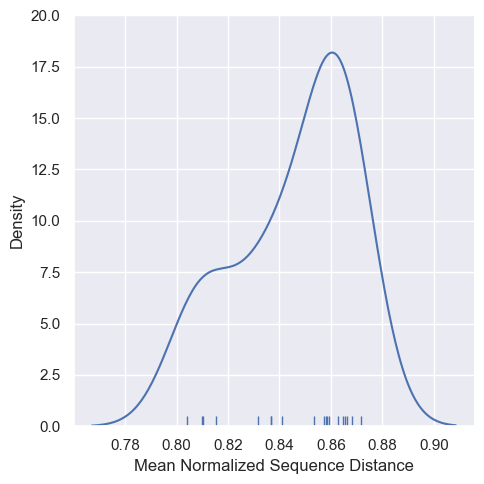

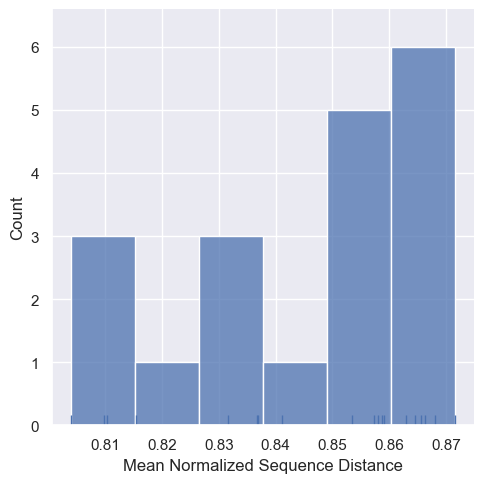

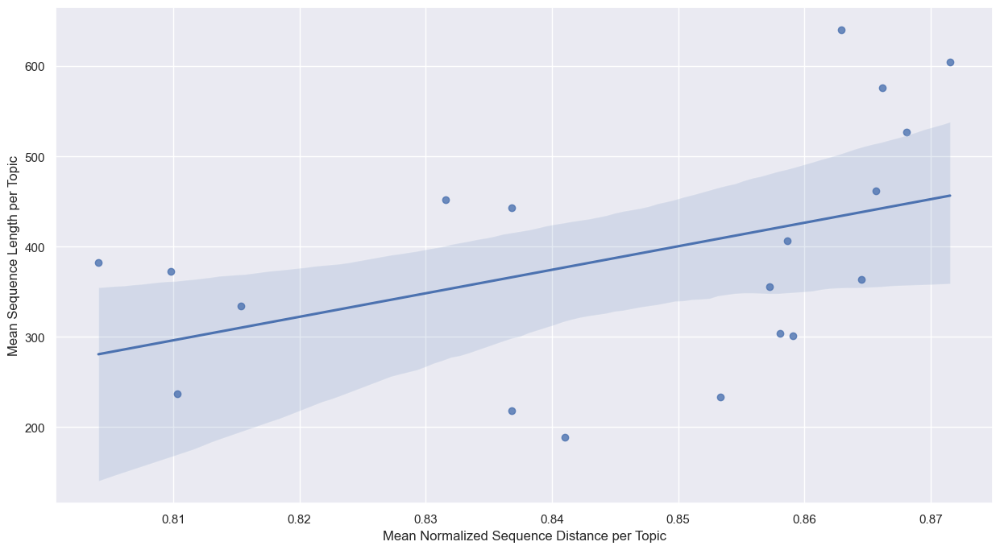

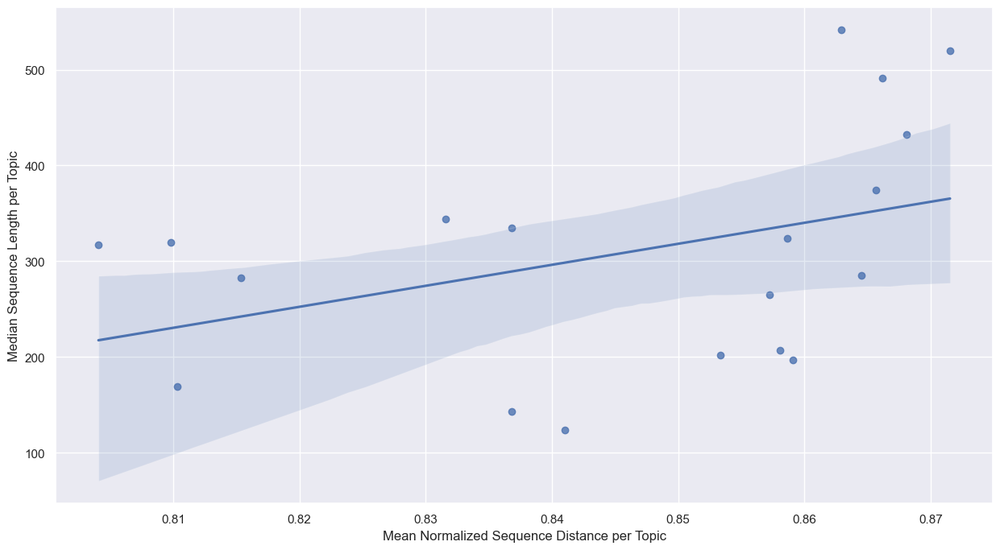

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


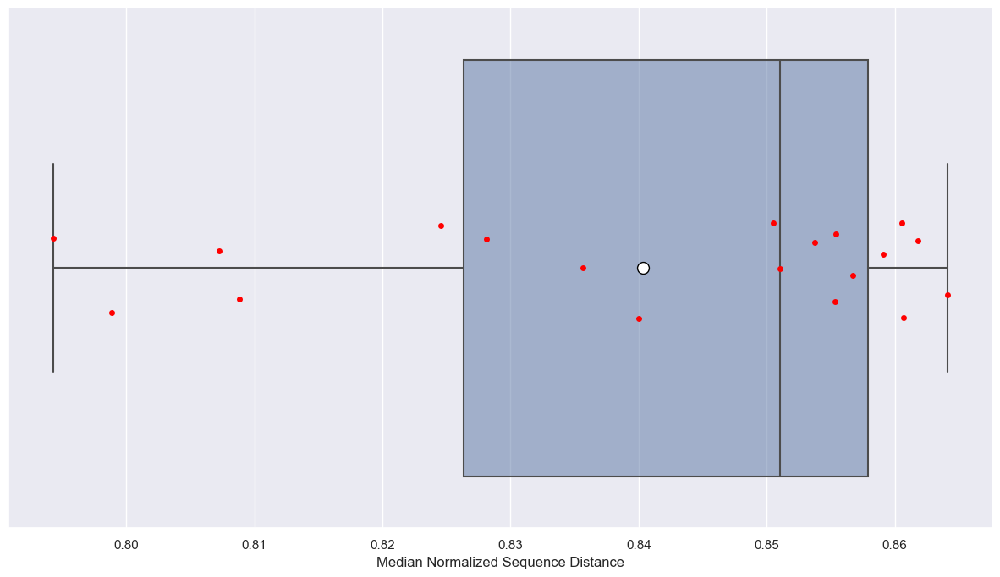

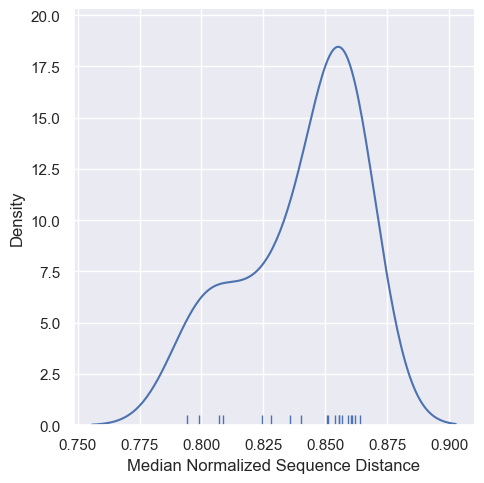

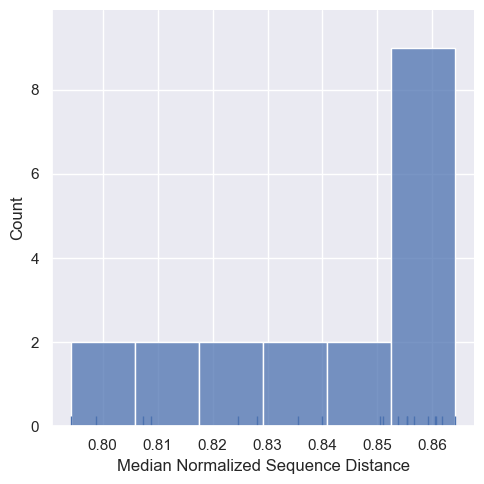

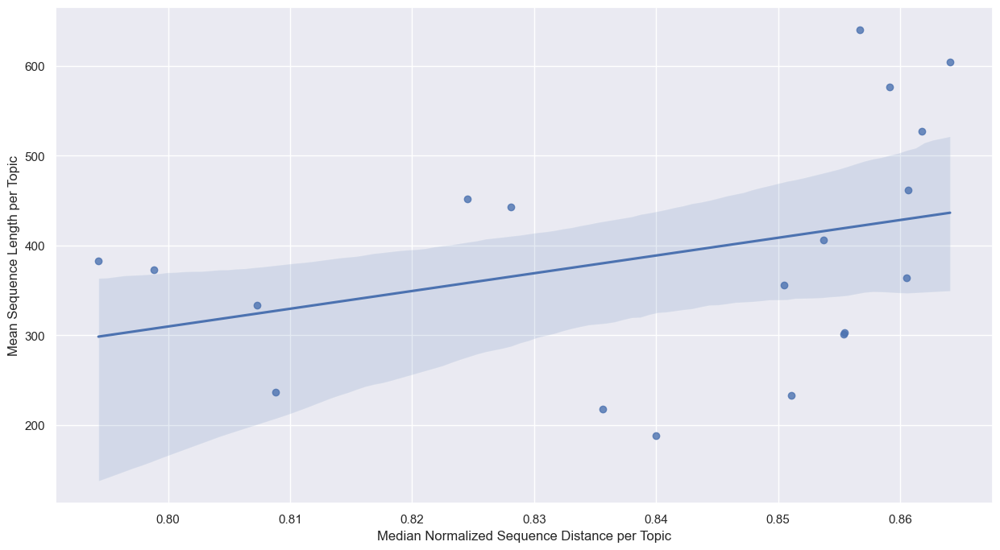

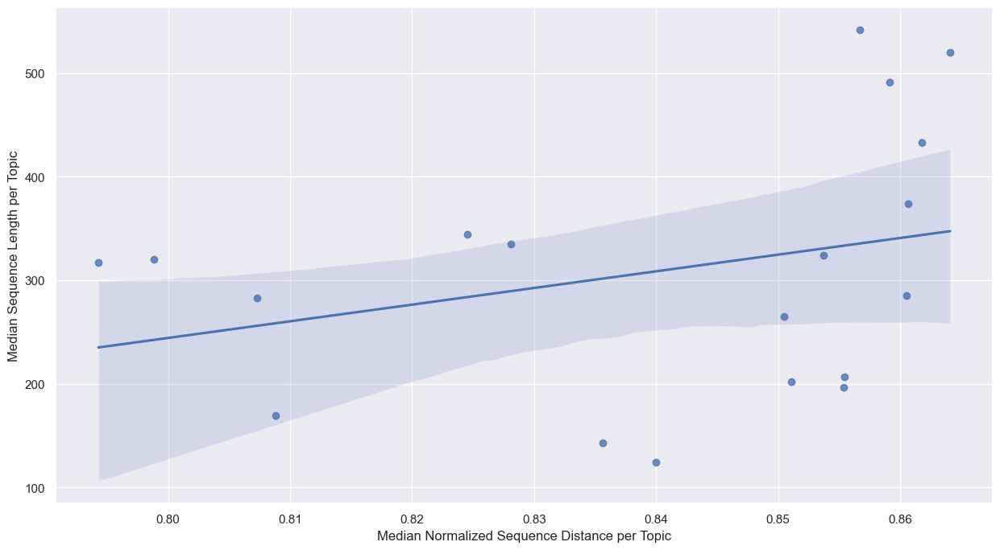

****************************************************************************************************
****************************************************************************************************
 


In [35]:
plot_sequence_distances(seq_distances)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


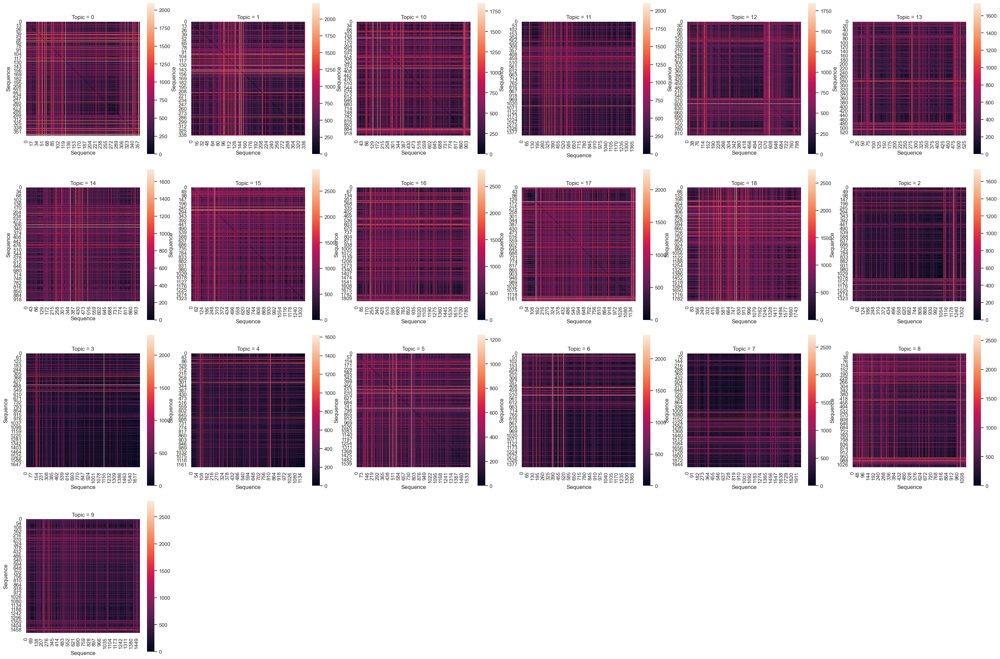

In [36]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        False,
                                        5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


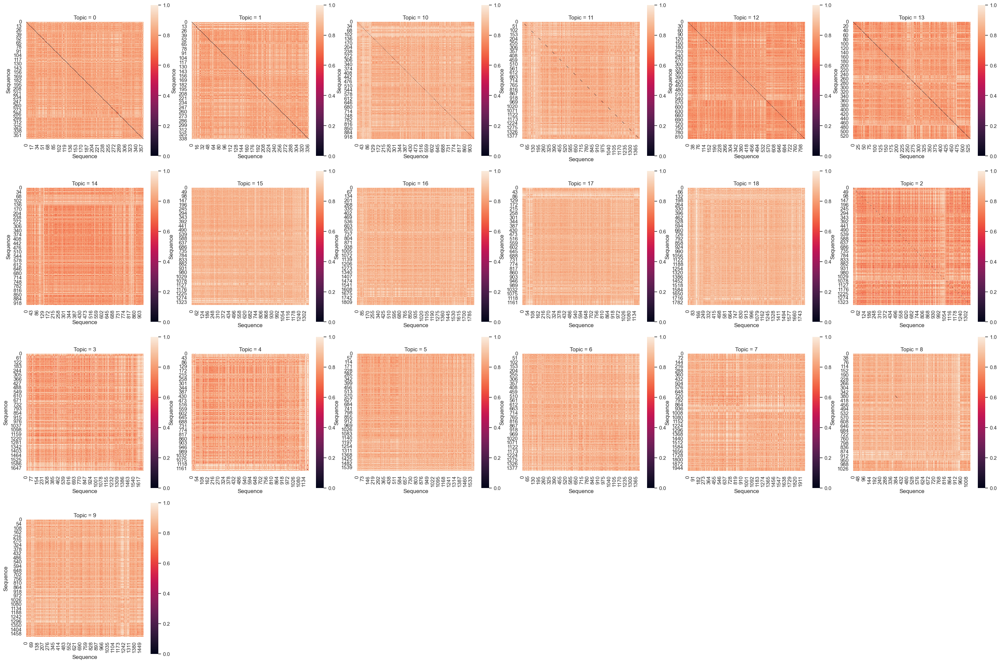

In [37]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        True,
                                        5)

## Clustering of Sequence Distances and Testing for Evaluation Metric Central Tendency Differences between Clusters 

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Topic Selection Criteria
----------------------------------------------------------------------------------------------------
 
Unique vs Total Number of Sequences per Topic:


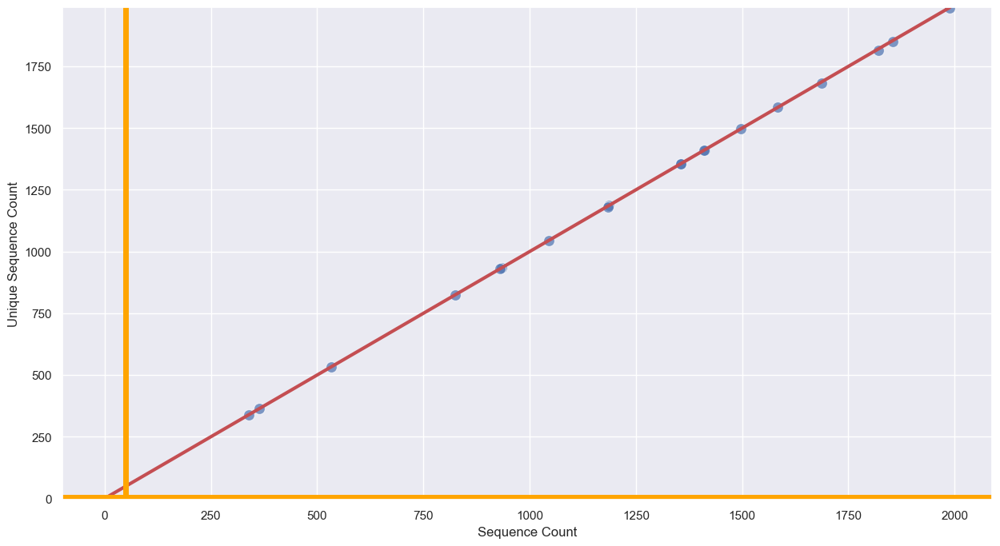

Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations


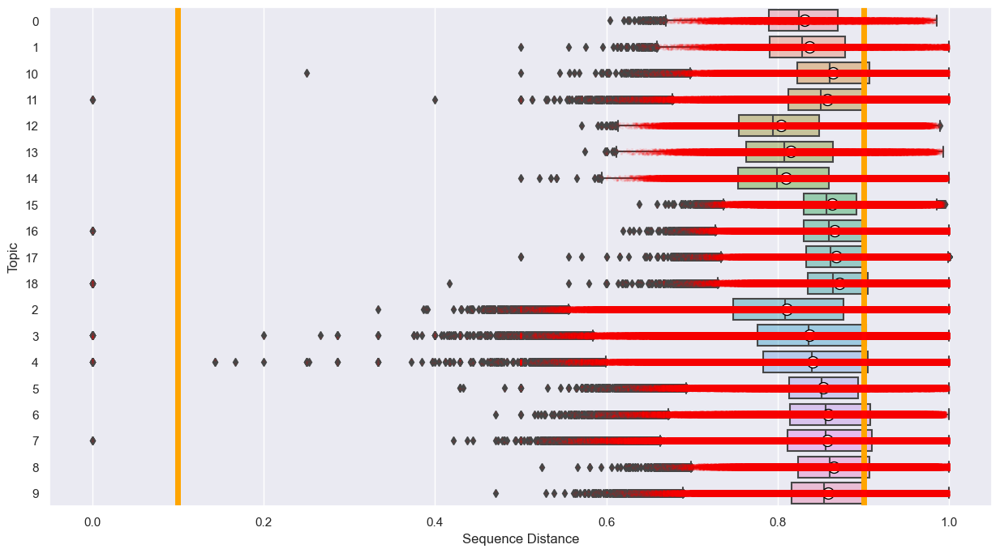

 
****************************************************************************************************
****************************************************************************************************


In [38]:
ClusterAnalysisPlotGroupSelectionCriteria(DATASET_NAME,
                                          learning_activity_sequence_stats_per_group,
                                          seq_distances,
                                          True,
                                          50,
                                          5,
                                          (0.1, 0.9)).display_group_selection_criteria()

In [51]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_SCORE_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 50,
                                 5,
                                 (0.1, 0.9),
                                 hdbscan.HDBSCAN,
                                 0.0001,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom',
                                 min_samples=3)

In [52]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()
cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups()

 53%|█████▎    | 10/19 [00:16<00:14,  1.64s/it]/opt/anaconda3/envs/DDIA/lib/python3.9/site-packages/pingouin/parametric.py:1343: RuntimeWarning: invalid value encountered in double_scalars
  adj_grandmean = (weights * grp.mean()).sum() / weights.sum()
100%|██████████| 19/19 [00:30<00:00,  1.60s/it]


In [53]:
pickle_write(cluster_eval,
             PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

In [54]:
cluster_stats_per_group = cluster_eval.cluster_stats_per_group
cluster_eval_metric_central_tendency_differences_per_group = cluster_eval.cluster_eval_metric_central_tendency_differences_per_group
aggregate_sequence_clustering_and_eval_metric_diff_test = cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test
group_cluster_analysis_inclusion_status = cluster_eval.group_cluster_analysis_inclusion_status
min_cluster_size_correction_df = cluster_eval.min_cluster_size_correction_df

In [55]:
cluster_stats_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Percentage Clustered,Cluster,Number of Sequences per Cluster,Number of Unique Sequences per Cluster,User,Sequence ID,Sequence Length,Sequence Array,Mean Evaluation Metric,Median Evaluation Metrice,Min Evaluation Metric Value,Max Evaluation Metric Value,STD Evaluation Metric Value,IQR Evaluation Metric Value
0,open_university,0,363,363,84.022039,-1,58,58,"[104, 123, 125, 126, 131, 134, 143, 145, 154, ...","[6, 27, 29, 30, 36, 39, 48, 50, 60, 68, 79, 86...","[221, 284, 745, 211, 653, 689, 189, 604, 334, ...","[(1, 21, 1, 0, 21, 1, 0, 1, 5, 0, 13, 10, 5, 0...",67.229454,69.1,36.2,84.0,12.104133,16.175


In [56]:
cluster_eval_metric_central_tendency_differences_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Mean Normalized Sequence Distance,Median Normalized Sequence Distance,Min Normalized Sequence Distance,Max Normalized Sequence Distance,STD Normalized Sequence Distance,IQR Normalized Sequence Distance,Clustering Algorithm,HDBSCAN Min Cluster Size,Number of Clusters,Percentage Clustered,Mean Cluster Size,Median Cluster Size,Min Cluster Size,Max Cluster Size,STD Cluster Size,IQR Cluster Size,Cluster Comparision Evaluation Metric,Normality Test Shapiro P-Value,Normality Test Jarque-Bera P-Value,Normality Test D'Agostion-Pearson P-Value,Homoscedasticity Test Levene P-Value,Homoscedasticity Test Bartlett P-Value,Central Tendency Differences Test Type,Central Tendency Differences Test P-Value
0,open_university,0,363,363,0.831606,0.824561,0.604027,0.984962,0.056849,0.080241,HDBSCAN,2,2,84.022039,152.5,152.5,5,300,147.5,147.5,Topic Score,2.720174e-08,1.088804e-11,4.080291e-09,0.524779,0.631266,kruskal_wallis_test,0.007491


In [57]:
aggregate_sequence_clustering_and_eval_metric_diff_test.head(1)

,Unfiltered Number of Topics,Number of Topics,Percentage of Unfiltered Topics,Number of Topics with Multiple Clusters,Mean Number of Sequences per Topic,Median Number of Sequences per Topic,Min Number of Sequences per Topic,Max Number of Sequences per Topic,STD Number of Sequences per Topic,IQR Number of Sequences per Topic,Mean Number of Unique Sequences per Topic,Median Number of Unique Sequences per Topic,Min Number of Unique Sequences per Topic,Max Number of Unique Sequences per Topic,STD Number of Unique Sequences per Topic,IQR Number of Unique Sequences per Topic,Mean Number of Clusters per Topic,Median Number of Clusters per Topic,Min Number of Clusters per Topic,Max Number of Clusters per Topic,STD Number of Clusters per Topic,IQR Number of Clusters per Topic,Mean Number of Sequences per Topic with Multiple Clusters,Median Number of Sequences per Topic with Multiple Clusters,Min Number of Sequences per Topic with Multiple Clusters,Max Number of Sequences per Topic with Multiple Clusters,STD Number of Sequences per Topic with Multiple Clusters,IQR Number of Sequences per Topic with Multiple Clusters,Mean Number of Unique Sequences per Topic with Multiple Clusters,Median Number of Unique Sequences per Topic with Multiple Clusters,Min Number of Unique Sequences per Topic with Multiple Clusters,Max Number of Unique Sequences per Topic with Multiple Clusters,STD Number of Unique Sequences per Topic with Multiple Clusters,IQR Number of Unique Sequences per Topic with Multiple Clusters,Mean Number of Clusters per Topic with Multiple Clusters,Median Number of Clusters per Topic with Multiple Clusters,Min Number of Clusters per Topic with Multiple Clusters,Max Number of Clusters per Topic with Multiple Clusters,STD Number of Clusters per Topic with Multiple Clusters,IQR Number of Clusters per Topic with Multiple Clusters,Number of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics with Multiple Clusters Significant Differeces Eval Metric Central Tendencies between Clusters
Dataset Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
open_university,19,19,1.0,19,1226.578947,1355.0,339,1989,484.452419,607.5,1225.368421,1355.0,339,1987,483.446792,607.5,16.842105,3.0,2,105,30.937685,5.0,1226.578947,1355.0,339,1989,484.452419,607.5,1225.368421,1355.0,339,1987,483.446792,607.5,16.842105,3.0,2,105,30.937685,5.0,6,31.578947,31.578947


In [58]:
group_cluster_analysis_inclusion_status.head(1)

,Dataset Name,Topic,Topic Included in Cluster Analysis,Minium Sequence Number Threshold Value,Minium Sequence Number Violated,Minium Unique Sequence Number Threshold Value,Minium Unique Sequence Number Violated,Sequence Distance Range Threshold Value,Sequence Distance Range Violated
0,open_university,0,True,50,False,5,False,"(0.1, 0.9)",False


In [59]:
min_cluster_size_correction_df.head(1)

,Dataset Name,Topic,Minimum Cluster Size Is Corrected,Uncorrected Minimum Cluster Size,Corrected Minimum Cluster Size
0,open_university,0,True,0,2


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Included Topics
----------------------------------------------------------------------------------------------------
 
19 Topics out of 19 are included in Cluster Analysis:


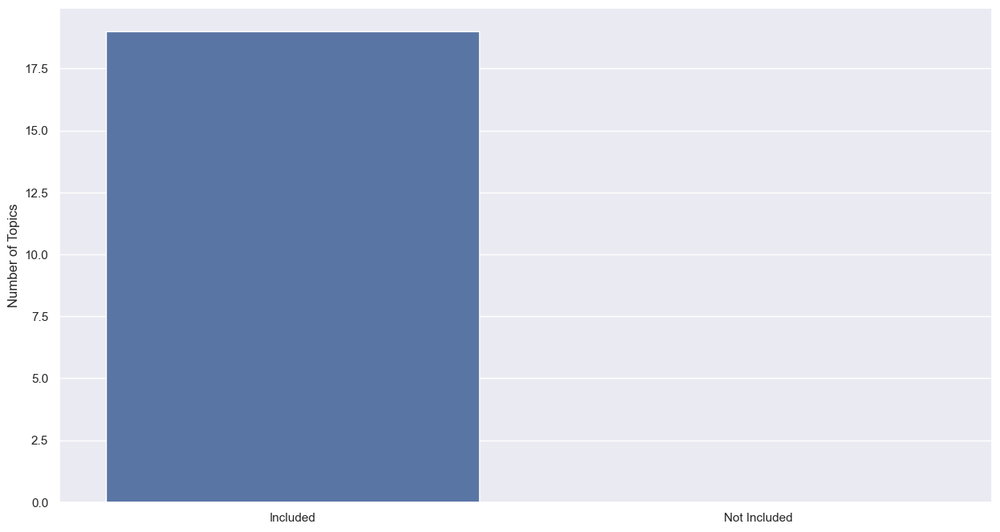

100.0% of Topics are included in Cluster Analysis:


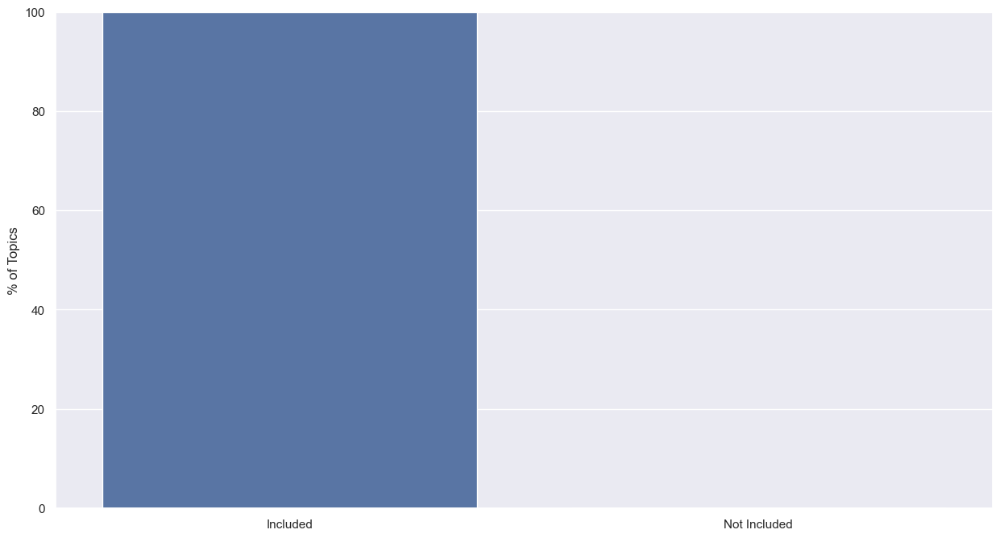

In [60]:
cluster_eval.display_included_groups()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters per Topic:
----------------------------------------------------------------------------------------------------


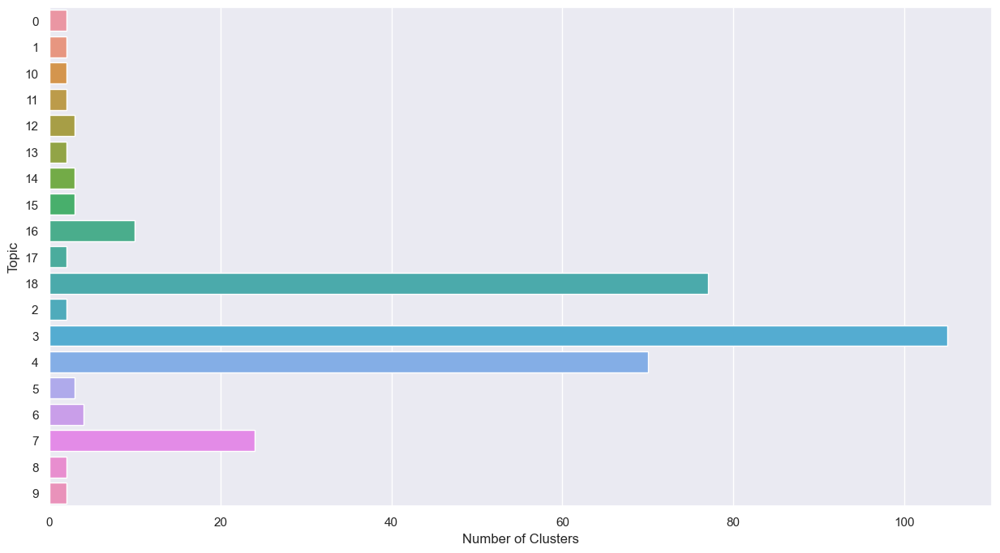

In [61]:
cluster_eval.display_number_of_clusters_all_group()

In [62]:
cluster_eval.print_number_of_clusters_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters for each Topic:
----------------------------------------------------------------------------------------------------
Topic  Number of Clusters
    0                   2
    2                   2
    8                   2
   13                   2
   17                   2
   11                   2
   10                   2
    1                   2
    9                   2
   14                   3
   15                   3
    5                   3
   12                   3
    6                   4
   16                  10
    7                  24
    4                  70
   18                  77
    3                 105


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------


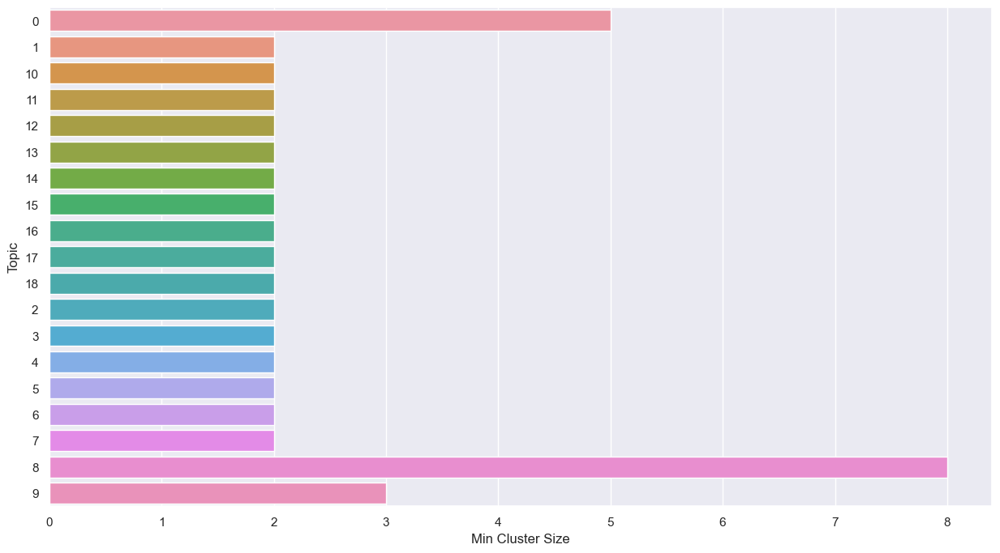

In [63]:
cluster_eval.display_min_cluster_size_all_group()

In [64]:
cluster_eval.print_min_cluster_sizes_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------
Topic  Min Cluster Size
   17                 2
    1                 2
   10                 2
   11                 2
   12                 2
   13                 2
   14                 2
   15                 2
   16                 2
    7                 2
   18                 2
    2                 2
    3                 2
    4                 2
    5                 2
    6                 2
    9                 3
    0                 5
    8                 8


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------


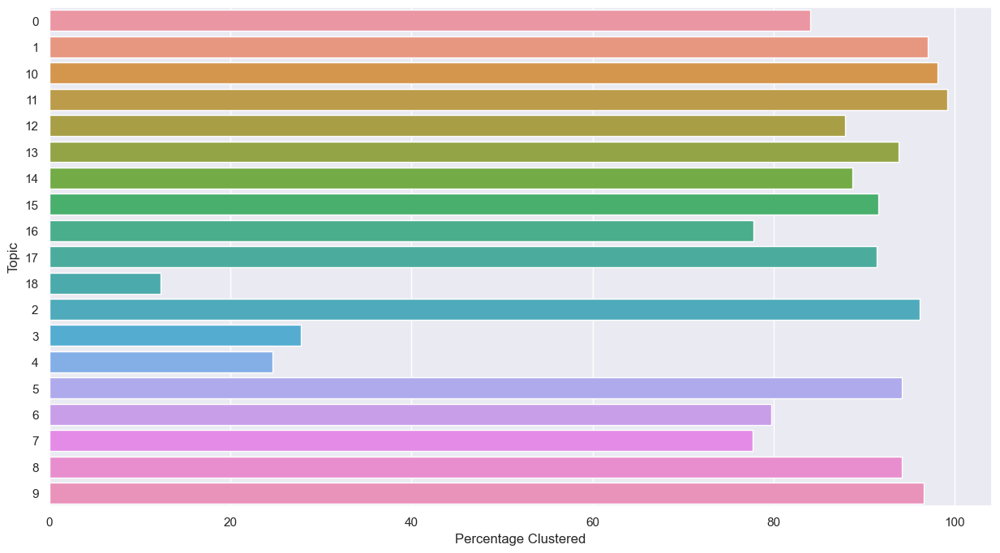

In [65]:
cluster_eval.display_percentage_clustered_all_group()

In [66]:
cluster_eval.print_percentage_clustered_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------
Topic  Percentage Clustered
   18             12.252747
    4             24.641350
    3             27.741553
    7             77.626948
   16             77.777778
    6             79.716312
    0             84.022039
   12             87.878788
   14             88.721805
   17             91.399663
   15             91.519174
   13             93.820225
    5             94.128788
    8             94.162679
    2             96.088561
    9             96.590909
    1             97.050147
   10             98.072805
   11             99.150142


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


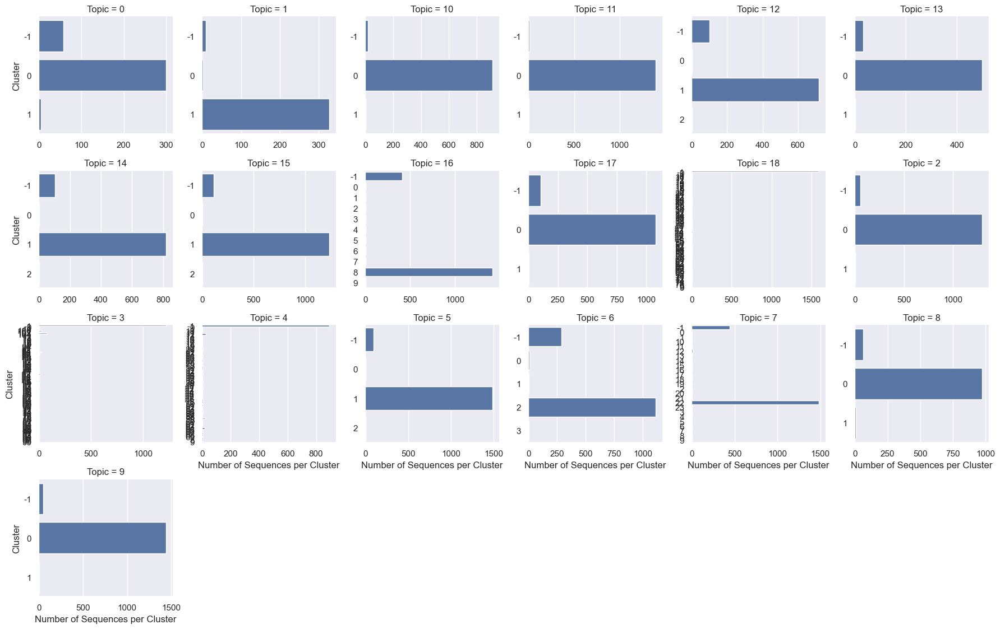

In [67]:
cluster_eval.display_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


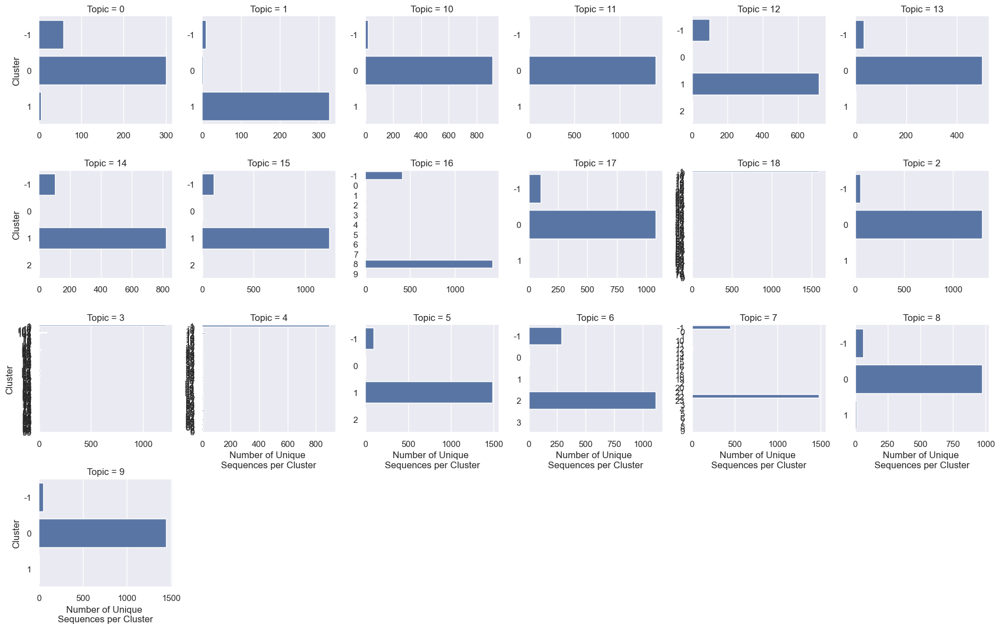

In [68]:
cluster_eval.display_number_unique_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences vs Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


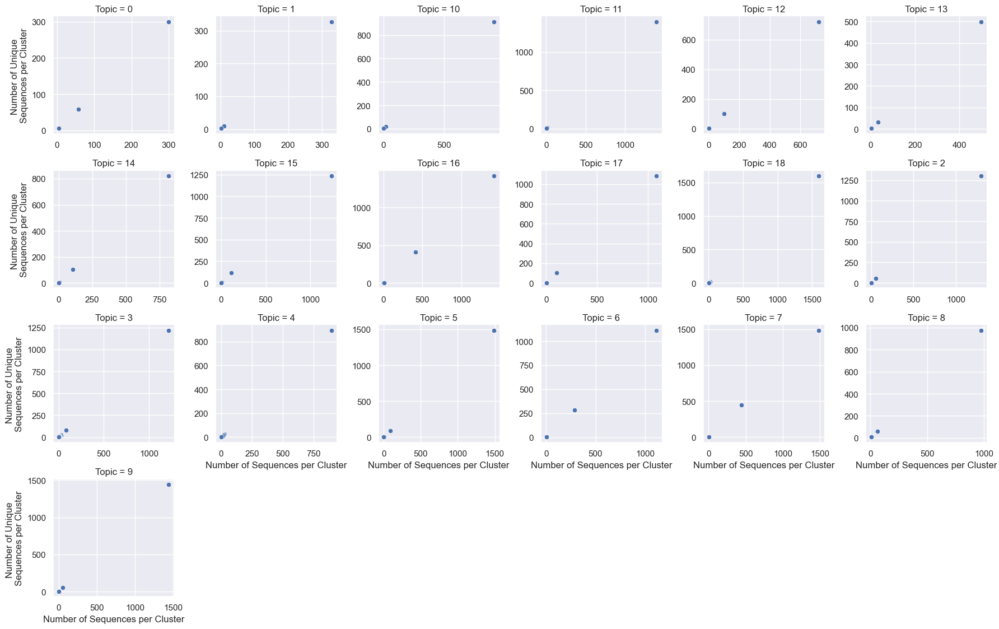

In [69]:
cluster_eval.display_number_unique_sequences_vs_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Central Tendency Differences in Evaluation Metric between Clusters per Topic:
Chosen Evaluation Metric: "Topic Score"
----------------------------------------------------------------------------------------------------


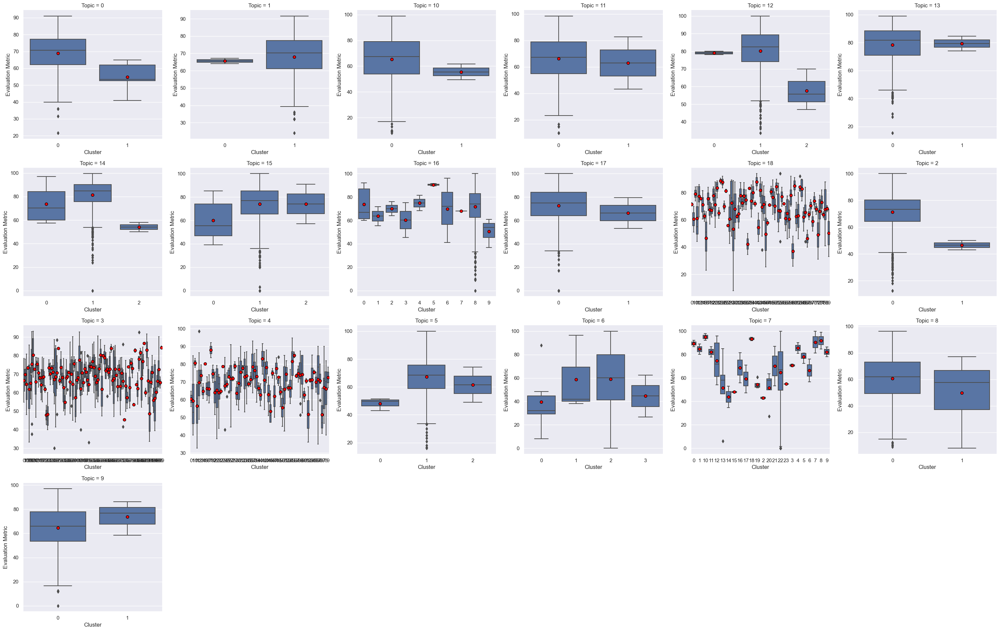

In [70]:
cluster_eval.display_eval_metric_dist_between_cluster_all_groups(height=5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Clusters per Topic
Dimensionality Reducer: UMAP
----------------------------------------------------------------------------------------------------


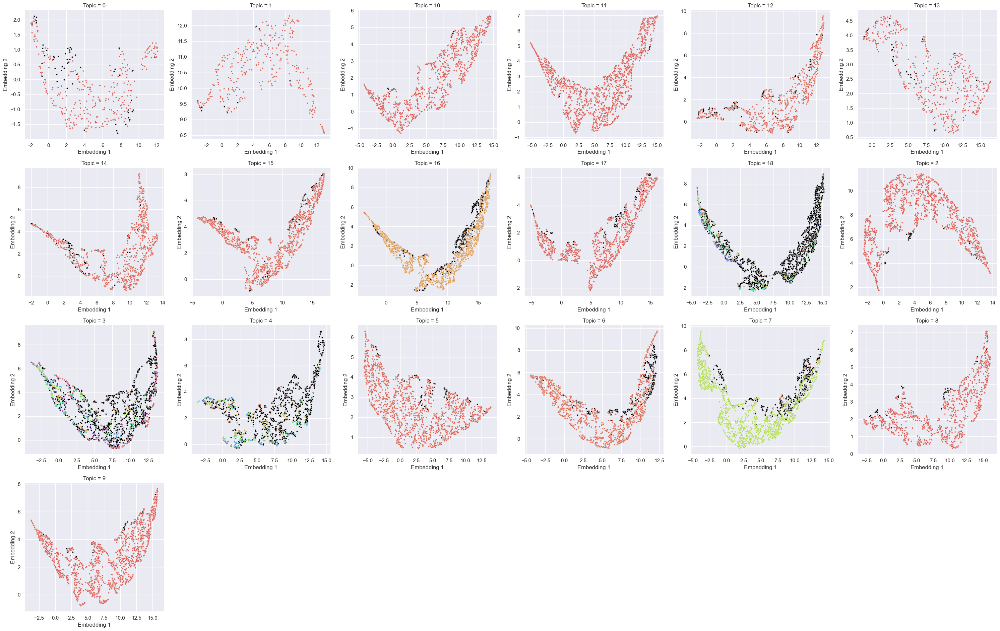

In [71]:
cluster_eval.display_clusters_all_group_umap(height=5)